## An example workflow

In [1]:
#to use the full width of the browser window uncomment the code below and execute the cell
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [1]:
from pyPoseidon.model import *
from pyPoseidon.dem import *
from pyPoseidon.meteo import *
import datetime
from pyPoseidon.utils.data import *


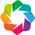

In [2]:
import holoviews as hv
import geoviews as gv
import geoviews.feature as gf
from cartopy import crs


hv.notebook_extension('bokeh')

In [3]:
#wrf out nc file
filename = '/Users/brey/Downloads/wrf_uvp.nc'

In [4]:
ds=xr.open_dataset(filename)

In [5]:
ds

<xarray.Dataset>
Dimensions:    (latitude: 150, longitude: 150, time: 217, x: 150, y: 150)
Coordinates:
  * latitude   (latitude) float32 32.795 32.885 32.975 33.065 33.155 33.245 ...
  * longitude  (longitude) float32 19.795 19.885 19.975 20.065 20.155 20.245 ...
  * time       (time) datetime64[ns] 2018-01-11 2018-01-11T01:00:00 ...
Dimensions without coordinates: x, y
Data variables:
    u10        (time, latitude, longitude) float32 ...
    v10        (time, latitude, longitude) float32 ...
    msl        (time, latitude, longitude) float32 ...
    lons       (x, y) float32 ...
    lats       (x, y) float32 ...

In [6]:
#get range of lat/lon window
minlon, maxlon = ds.lons.min().values +.1,ds.lons.max().values-.1
minlat, maxlat = ds.lats.min().values+.1,ds.lats.max().values-.1
# time range
start_date = ds.time.to_pandas()[0]
end_date = ds.time.to_pandas()[-1]

In [20]:
#define in a dictionary the properties of the model..
dic={'minlon':minlon, # lat/lon window
     'maxlon':maxlon,
     'minlat':minlat,
     'maxlat':maxlat,
     'solver':'d3d',
     'resolution':0.2, #grid resoltuion 
     'step':60, # step for output of map field in d3d
     'start_date':start_date,
     'end_date':end_date,
#     'meteo':'hnms_oper',
#     'meteo':'ecmwf_oper',
     'meteo':'generic',
     'dem': 'gebco',
     'dpath' : '~/DATA/GEBCO_2014_2D.nc',
#     'exec':'/Users/brey/DELFT3D/bin/lnx64/', #exec folder of solver 
     'ncores': 4 , #number of cores
     'rpath':'/Users/brey/Downloads/test/', #location of calc folder
     'conda_env':'mpi2' # optional conda env for running the solver
    }

In [21]:
dic.update({'mpaths':filename})

In [22]:
#initialize a model
b = model(**dic)

### set it up

In [23]:
b.set() #set it up 


extracting dem from ~/DATA/GEBCO_2014_2D.nc

dem done

extracting meteo from /Users/brey/Downloads/wrf_uvp.nc

meteo done


## output 

In [24]:
#set the run by saving the files
b.output()

In [25]:
# save model info for further use
b.save()

In [26]:
# save all matrices for further use
#b.pickle(path=path)

### execute

In [27]:
#execute
b.run()

MPI process number 000 has host unknown and is running on processor dmapcgf.isferea.project
MPI process number 001 has host unknown and is running on processor dmapcgf.isferea.project
MPI process number 002 has host unknown and is running on processor dmapcgf.isferea.project
MPI process number 003 has host unknown and is running on processor dmapcgf.isferea.project
--------------------------------------------------------------------------------
       Deltares, FLOW2D3D Version 6.02.10.7072, Jan 29 2018, 12:55:29
       libflow2d3d.so entry Flow2D3D::Run
--------------------------------------------------------------------------------

Part I    - Initialisation Time Dep. Data module...    
            runid : d3d
Part II   - Creating intermediate files...             
Part III  - Initialisation of the Execution module...  
Part IV   - Reading complete MD-file...                     
Part V    - Initialisation & checking input...              
Part VI   - Initialisation & checking secon

  Time to finish   1m  6s,    0.8% completed, time steps left  12857
  Time to finish   1m  6s,    0.8% completed, time steps left  12856
  Time to finish   1m  6s,    0.8% completed, time steps left  12855
  Time to finish   1m  6s,    0.8% completed, time steps left  12854
  Time to finish   1m  6s,    0.8% completed, time steps left  12853
  Time to finish   1m  6s,    0.8% completed, time steps left  12852
  Time to finish   1m  6s,    0.8% completed, time steps left  12851
  Time to finish   1m  6s,    0.8% completed, time steps left  12850
  Time to finish   1m  6s,    0.9% completed, time steps left  12849
  Time to finish   1m  6s,    0.9% completed, time steps left  12848
  Time to finish   1m  5s,    0.9% completed, time steps left  12847
  Time to finish   1m  5s,    0.9% completed, time steps left  12846
  Time to finish   1m  5s,    0.9% completed, time steps left  12845
  Time to finish   1m  5s,    0.9% completed, time steps left  12844
  Time to finish   1m  5s,    0.9%

  Time to finish   1m  7s,    1.7% completed, time steps left  12738
  Time to finish   1m  7s,    1.7% completed, time steps left  12737
  Time to finish   1m  7s,    1.7% completed, time steps left  12736
  Time to finish   1m  7s,    1.7% completed, time steps left  12735
  Time to finish   1m  7s,    1.7% completed, time steps left  12734
  Time to finish   1m  7s,    1.8% completed, time steps left  12733
  Time to finish   1m  7s,    1.8% completed, time steps left  12732
  Time to finish   1m  7s,    1.8% completed, time steps left  12731
  Time to finish   1m  7s,    1.8% completed, time steps left  12730
  Time to finish   1m  7s,    1.8% completed, time steps left  12729
  Time to finish   1m  7s,    1.8% completed, time steps left  12728
  Time to finish   1m  7s,    1.8% completed, time steps left  12727
  Time to finish   1m  7s,    1.8% completed, time steps left  12726
  Time to finish   1m  7s,    1.8% completed, time steps left  12725
  Time to finish   1m  7s,    1.8%

  Time to finish   1m  8s,    2.6% completed, time steps left  12619
  Time to finish   1m  8s,    2.6% completed, time steps left  12618
  Time to finish   1m  8s,    2.6% completed, time steps left  12617
  Time to finish   1m  8s,    2.7% completed, time steps left  12616
  Time to finish   1m  8s,    2.7% completed, time steps left  12615
  Time to finish   1m  8s,    2.7% completed, time steps left  12614
  Time to finish   1m  8s,    2.7% completed, time steps left  12613
  Time to finish   1m  8s,    2.7% completed, time steps left  12612
  Time to finish   1m  8s,    2.7% completed, time steps left  12611
  Time to finish   1m  8s,    2.7% completed, time steps left  12610
  Time to finish   1m  8s,    2.7% completed, time steps left  12609
  Time to finish   1m  8s,    2.7% completed, time steps left  12608
  Time to finish   1m  8s,    2.7% completed, time steps left  12607
  Time to finish   1m  8s,    2.7% completed, time steps left  12606
  Time to finish   1m  8s,    2.7%

  Time to finish   1m  9s,    3.5% completed, time steps left  12500
  Time to finish   1m  9s,    3.6% completed, time steps left  12499
  Time to finish   1m  9s,    3.6% completed, time steps left  12498
  Time to finish   1m  8s,    3.6% completed, time steps left  12497
  Time to finish   1m  8s,    3.6% completed, time steps left  12496
  Time to finish   1m  8s,    3.6% completed, time steps left  12495
  Time to finish   1m  8s,    3.6% completed, time steps left  12494
  Time to finish   1m  8s,    3.6% completed, time steps left  12493
  Time to finish   1m  8s,    3.6% completed, time steps left  12492
  Time to finish   1m  8s,    3.6% completed, time steps left  12491
  Time to finish   1m  8s,    3.6% completed, time steps left  12490
  Time to finish   1m  8s,    3.6% completed, time steps left  12489
  Time to finish   1m  8s,    3.6% completed, time steps left  12488
  Time to finish   1m  8s,    3.6% completed, time steps left  12487
  Time to finish   1m  8s,    3.7%

  Time to finish   1m  8s,    4.5% completed, time steps left  12381
  Time to finish   1m  8s,    4.5% completed, time steps left  12380
  Time to finish   1m  8s,    4.5% completed, time steps left  12379
  Time to finish   1m  8s,    4.5% completed, time steps left  12378
  Time to finish   1m  7s,    4.5% completed, time steps left  12377
  Time to finish   1m  7s,    4.5% completed, time steps left  12376
  Time to finish   1m  7s,    4.5% completed, time steps left  12375
  Time to finish   1m  7s,    4.5% completed, time steps left  12374
  Time to finish   1m  7s,    4.5% completed, time steps left  12373
  Time to finish   1m  7s,    4.5% completed, time steps left  12372
  Time to finish   1m  7s,    4.5% completed, time steps left  12371
  Time to finish   1m  7s,    4.6% completed, time steps left  12370
  Time to finish   1m  7s,    4.6% completed, time steps left  12369
  Time to finish   1m  7s,    4.6% completed, time steps left  12368
  Time to finish   1m  7s,    4.6%

  Time to finish   1m  6s,    5.4% completed, time steps left  12262
  Time to finish   1m  6s,    5.4% completed, time steps left  12261
  Time to finish   1m  6s,    5.4% completed, time steps left  12260
  Time to finish   1m  6s,    5.4% completed, time steps left  12259
  Time to finish   1m  6s,    5.4% completed, time steps left  12258
  Time to finish   1m  6s,    5.4% completed, time steps left  12257
  Time to finish   1m  6s,    5.4% completed, time steps left  12256
  Time to finish   1m  6s,    5.4% completed, time steps left  12255
  Time to finish   1m  6s,    5.4% completed, time steps left  12254
  Time to finish   1m  6s,    5.5% completed, time steps left  12253
  Time to finish   1m  6s,    5.5% completed, time steps left  12252
  Time to finish   1m  6s,    5.5% completed, time steps left  12251
  Time to finish   1m  6s,    5.5% completed, time steps left  12250
  Time to finish   1m  6s,    5.5% completed, time steps left  12249
  Time to finish   1m  6s,    5.5%

  Time to finish   1m  5s,    6.3% completed, time steps left  12143
  Time to finish   1m  5s,    6.3% completed, time steps left  12142
  Time to finish   1m  5s,    6.3% completed, time steps left  12141
  Time to finish   1m  5s,    6.3% completed, time steps left  12140
  Time to finish   1m  5s,    6.3% completed, time steps left  12139
  Time to finish   1m  5s,    6.3% completed, time steps left  12138
  Time to finish   1m  5s,    6.4% completed, time steps left  12137
  Time to finish   1m  5s,    6.4% completed, time steps left  12136
  Time to finish   1m  5s,    6.4% completed, time steps left  12135
  Time to finish   1m  5s,    6.4% completed, time steps left  12134
  Time to finish   1m  5s,    6.4% completed, time steps left  12133
  Time to finish   1m  5s,    6.4% completed, time steps left  12132
  Time to finish   1m  5s,    6.4% completed, time steps left  12131
  Time to finish   1m  5s,    6.4% completed, time steps left  12130
  Time to finish   1m  5s,    6.4%

  Time to finish   1m  4s,    7.2% completed, time steps left  12024
  Time to finish   1m  4s,    7.2% completed, time steps left  12023
  Time to finish   1m  4s,    7.2% completed, time steps left  12022
  Time to finish   1m  4s,    7.2% completed, time steps left  12021
  Time to finish   1m  4s,    7.3% completed, time steps left  12020
  Time to finish   1m  4s,    7.3% completed, time steps left  12019
  Time to finish   1m  4s,    7.3% completed, time steps left  12018
  Time to finish   1m  4s,    7.3% completed, time steps left  12017
  Time to finish   1m  4s,    7.3% completed, time steps left  12016
  Time to finish   1m  4s,    7.3% completed, time steps left  12015
  Time to finish   1m  4s,    7.3% completed, time steps left  12014
  Time to finish   1m  4s,    7.3% completed, time steps left  12013
  Time to finish   1m  4s,    7.3% completed, time steps left  12012
  Time to finish   1m  4s,    7.3% completed, time steps left  12011
  Time to finish   1m  4s,    7.3%

  Time to finish   1m  3s,    8.1% completed, time steps left  11905
  Time to finish   1m  3s,    8.1% completed, time steps left  11904
  Time to finish   1m  3s,    8.2% completed, time steps left  11903
  Time to finish   1m  3s,    8.2% completed, time steps left  11902
  Time to finish   1m  3s,    8.2% completed, time steps left  11901
  Time to finish   1m  3s,    8.2% completed, time steps left  11900
  Time to finish   1m  3s,    8.2% completed, time steps left  11899
  Time to finish   1m  3s,    8.2% completed, time steps left  11898
  Time to finish   1m  3s,    8.2% completed, time steps left  11897
  Time to finish   1m  3s,    8.2% completed, time steps left  11896
  Time to finish   1m  3s,    8.2% completed, time steps left  11895
  Time to finish   1m  3s,    8.2% completed, time steps left  11894
  Time to finish   1m  3s,    8.2% completed, time steps left  11893
  Time to finish   1m  3s,    8.2% completed, time steps left  11892
  Time to finish   1m  3s,    8.2%

  Time to finish   1m  2s,    9.1% completed, time steps left  11786
  Time to finish   1m  2s,    9.1% completed, time steps left  11785
  Time to finish   1m  2s,    9.1% completed, time steps left  11784
  Time to finish   1m  2s,    9.1% completed, time steps left  11783
  Time to finish   1m  2s,    9.1% completed, time steps left  11782
  Time to finish   1m  2s,    9.1% completed, time steps left  11781
  Time to finish   1m  2s,    9.1% completed, time steps left  11780
  Time to finish   1m  2s,    9.1% completed, time steps left  11779
  Time to finish   1m  2s,    9.1% completed, time steps left  11778
  Time to finish   1m  2s,    9.1% completed, time steps left  11777
  Time to finish   1m  2s,    9.1% completed, time steps left  11776
  Time to finish   1m  2s,    9.1% completed, time steps left  11775
  Time to finish   1m  2s,    9.2% completed, time steps left  11774
  Time to finish   1m  2s,    9.2% completed, time steps left  11773
  Time to finish   1m  2s,    9.2%

  Time to finish   1m  1s,   10.0% completed, time steps left  11667
  Time to finish   1m  1s,   10.0% completed, time steps left  11666
  Time to finish   1m  1s,   10.0% completed, time steps left  11665
  Time to finish   1m  1s,   10.0% completed, time steps left  11664
  Time to finish   1m  1s,   10.0% completed, time steps left  11663
  Time to finish   1m  1s,   10.0% completed, time steps left  11662
  Time to finish   1m  1s,   10.0% completed, time steps left  11661
  Time to finish   1m  1s,   10.0% completed, time steps left  11660
  Time to finish   1m  1s,   10.0% completed, time steps left  11659
  Time to finish   1m  1s,   10.0% completed, time steps left  11658
  Time to finish   1m  1s,   10.1% completed, time steps left  11657
  Time to finish   1m  1s,   10.1% completed, time steps left  11656
  Time to finish   1m  1s,   10.1% completed, time steps left  11655
  Time to finish   1m  1s,   10.1% completed, time steps left  11654
  Time to finish   1m  1s,   10.1%

  Time to finish  60s,   10.9% completed, time steps left  11545
  Time to finish  60s,   10.9% completed, time steps left  11544
  Time to finish  60s,   10.9% completed, time steps left  11543
  Time to finish  60s,   10.9% completed, time steps left  11542
  Time to finish  60s,   10.9% completed, time steps left  11541
  Time to finish  60s,   11.0% completed, time steps left  11540
  Time to finish  60s,   11.0% completed, time steps left  11539
  Time to finish  60s,   11.0% completed, time steps left  11538
  Time to finish  60s,   11.0% completed, time steps left  11537
  Time to finish  60s,   11.0% completed, time steps left  11536
  Time to finish  60s,   11.0% completed, time steps left  11535
  Time to finish  60s,   11.0% completed, time steps left  11534
  Time to finish  60s,   11.0% completed, time steps left  11533
  Time to finish  60s,   11.0% completed, time steps left  11532
  Time to finish  60s,   11.0% completed, time steps left  11531
  Time to finish  60s,   

  Time to finish  59s,   11.9% completed, time steps left  11418
  Time to finish  59s,   11.9% completed, time steps left  11417
  Time to finish  59s,   11.9% completed, time steps left  11416
  Time to finish  59s,   11.9% completed, time steps left  11415
  Time to finish  59s,   11.9% completed, time steps left  11414
  Time to finish  59s,   11.9% completed, time steps left  11413
  Time to finish  59s,   11.9% completed, time steps left  11412
  Time to finish  59s,   12.0% completed, time steps left  11411
  Time to finish  59s,   12.0% completed, time steps left  11410
  Time to finish  59s,   12.0% completed, time steps left  11409
  Time to finish  59s,   12.0% completed, time steps left  11408
  Time to finish  59s,   12.0% completed, time steps left  11407
  Time to finish  59s,   12.0% completed, time steps left  11406
  Time to finish  59s,   12.0% completed, time steps left  11405
  Time to finish  59s,   12.0% completed, time steps left  11404
  Time to finish  59s,   

  Time to finish  58s,   12.9% completed, time steps left  11291
  Time to finish  58s,   12.9% completed, time steps left  11290
  Time to finish  58s,   12.9% completed, time steps left  11289
  Time to finish  58s,   12.9% completed, time steps left  11288
  Time to finish  58s,   12.9% completed, time steps left  11287
  Time to finish  58s,   12.9% completed, time steps left  11286
  Time to finish  58s,   12.9% completed, time steps left  11285
  Time to finish  58s,   12.9% completed, time steps left  11284
  Time to finish  58s,   12.9% completed, time steps left  11283
  Time to finish  58s,   12.9% completed, time steps left  11282
  Time to finish  58s,   13.0% completed, time steps left  11281
  Time to finish  58s,   13.0% completed, time steps left  11280
  Time to finish  58s,   13.0% completed, time steps left  11279
  Time to finish  58s,   13.0% completed, time steps left  11278
  Time to finish  58s,   13.0% completed, time steps left  11277
  Time to finish  58s,   

  Time to finish  58s,   13.9% completed, time steps left  11164
  Time to finish  58s,   13.9% completed, time steps left  11163
  Time to finish  58s,   13.9% completed, time steps left  11162
  Time to finish  58s,   13.9% completed, time steps left  11161
  Time to finish  58s,   13.9% completed, time steps left  11160
  Time to finish  58s,   13.9% completed, time steps left  11159
  Time to finish  58s,   13.9% completed, time steps left  11158
  Time to finish  58s,   13.9% completed, time steps left  11157
  Time to finish  58s,   13.9% completed, time steps left  11156
  Time to finish  58s,   13.9% completed, time steps left  11155
  Time to finish  58s,   13.9% completed, time steps left  11154
  Time to finish  58s,   13.9% completed, time steps left  11153
  Time to finish  58s,   14.0% completed, time steps left  11152
  Time to finish  58s,   14.0% completed, time steps left  11151
  Time to finish  58s,   14.0% completed, time steps left  11150
  Time to finish  58s,   

  Time to finish  57s,   14.8% completed, time steps left  11037
  Time to finish  57s,   14.8% completed, time steps left  11036
  Time to finish  57s,   14.9% completed, time steps left  11035
  Time to finish  57s,   14.9% completed, time steps left  11034
  Time to finish  57s,   14.9% completed, time steps left  11033
  Time to finish  57s,   14.9% completed, time steps left  11032
  Time to finish  57s,   14.9% completed, time steps left  11031
  Time to finish  57s,   14.9% completed, time steps left  11030
  Time to finish  57s,   14.9% completed, time steps left  11029
  Time to finish  57s,   14.9% completed, time steps left  11028
  Time to finish  57s,   14.9% completed, time steps left  11027
  Time to finish  57s,   14.9% completed, time steps left  11026
  Time to finish  57s,   14.9% completed, time steps left  11025
  Time to finish  57s,   14.9% completed, time steps left  11024
  Time to finish  57s,   14.9% completed, time steps left  11023
  Time to finish  57s,   

  Time to finish  57s,   15.8% completed, time steps left  10910
  Time to finish  57s,   15.8% completed, time steps left  10909
  Time to finish  57s,   15.8% completed, time steps left  10908
  Time to finish  57s,   15.8% completed, time steps left  10907
  Time to finish  57s,   15.8% completed, time steps left  10906
  Time to finish  56s,   15.9% completed, time steps left  10905
  Time to finish  56s,   15.9% completed, time steps left  10904
  Time to finish  56s,   15.9% completed, time steps left  10903
  Time to finish  56s,   15.9% completed, time steps left  10902
  Time to finish  56s,   15.9% completed, time steps left  10901
  Time to finish  56s,   15.9% completed, time steps left  10900
  Time to finish  56s,   15.9% completed, time steps left  10899
  Time to finish  56s,   15.9% completed, time steps left  10898
  Time to finish  56s,   15.9% completed, time steps left  10897
  Time to finish  56s,   15.9% completed, time steps left  10896
  Time to finish  56s,   

  Time to finish  56s,   16.8% completed, time steps left  10783
  Time to finish  56s,   16.8% completed, time steps left  10782
  Time to finish  56s,   16.8% completed, time steps left  10781
  Time to finish  56s,   16.8% completed, time steps left  10780
  Time to finish  56s,   16.8% completed, time steps left  10779
  Time to finish  56s,   16.8% completed, time steps left  10778
  Time to finish  56s,   16.8% completed, time steps left  10777
  Time to finish  56s,   16.9% completed, time steps left  10776
  Time to finish  56s,   16.9% completed, time steps left  10775
  Time to finish  56s,   16.9% completed, time steps left  10774
  Time to finish  56s,   16.9% completed, time steps left  10773
  Time to finish  56s,   16.9% completed, time steps left  10772
  Time to finish  56s,   16.9% completed, time steps left  10771
  Time to finish  56s,   16.9% completed, time steps left  10770
  Time to finish  56s,   16.9% completed, time steps left  10769
  Time to finish  56s,   

  Time to finish  56s,   17.8% completed, time steps left  10656
  Time to finish  56s,   17.8% completed, time steps left  10655
  Time to finish  56s,   17.8% completed, time steps left  10654
  Time to finish  56s,   17.8% completed, time steps left  10653
  Time to finish  55s,   17.8% completed, time steps left  10652
  Time to finish  55s,   17.8% completed, time steps left  10651
  Time to finish  55s,   17.8% completed, time steps left  10650
  Time to finish  55s,   17.8% completed, time steps left  10649
  Time to finish  55s,   17.8% completed, time steps left  10648
  Time to finish  55s,   17.8% completed, time steps left  10647
  Time to finish  55s,   17.9% completed, time steps left  10646
  Time to finish  55s,   17.9% completed, time steps left  10645
  Time to finish  55s,   17.9% completed, time steps left  10644
  Time to finish  55s,   17.9% completed, time steps left  10643
  Time to finish  55s,   17.9% completed, time steps left  10642
  Time to finish  55s,   

  Time to finish  55s,   18.8% completed, time steps left  10529
  Time to finish  55s,   18.8% completed, time steps left  10528
  Time to finish  55s,   18.8% completed, time steps left  10527
  Time to finish  55s,   18.8% completed, time steps left  10526
  Time to finish  55s,   18.8% completed, time steps left  10525
  Time to finish  55s,   18.8% completed, time steps left  10524
  Time to finish  55s,   18.8% completed, time steps left  10523
  Time to finish  55s,   18.8% completed, time steps left  10522
  Time to finish  55s,   18.8% completed, time steps left  10521
  Time to finish  55s,   18.8% completed, time steps left  10520
  Time to finish  55s,   18.8% completed, time steps left  10519
  Time to finish  55s,   18.8% completed, time steps left  10518
  Time to finish  55s,   18.9% completed, time steps left  10517
  Time to finish  55s,   18.9% completed, time steps left  10516
  Time to finish  55s,   18.9% completed, time steps left  10515
  Time to finish  55s,   

  Time to finish  55s,   19.7% completed, time steps left  10402
  Time to finish  55s,   19.7% completed, time steps left  10401
  Time to finish  55s,   19.8% completed, time steps left  10400
  Time to finish  55s,   19.8% completed, time steps left  10399
  Time to finish  55s,   19.8% completed, time steps left  10398
  Time to finish  55s,   19.8% completed, time steps left  10397
  Time to finish  55s,   19.8% completed, time steps left  10396
  Time to finish  55s,   19.8% completed, time steps left  10395
  Time to finish  55s,   19.8% completed, time steps left  10394
  Time to finish  55s,   19.8% completed, time steps left  10393
  Time to finish  55s,   19.8% completed, time steps left  10392
  Time to finish  55s,   19.8% completed, time steps left  10391
  Time to finish  55s,   19.8% completed, time steps left  10390
  Time to finish  54s,   19.8% completed, time steps left  10389
  Time to finish  54s,   19.8% completed, time steps left  10388
  Time to finish  54s,   

  Time to finish  54s,   20.7% completed, time steps left  10275
  Time to finish  54s,   20.7% completed, time steps left  10274
  Time to finish  54s,   20.7% completed, time steps left  10273
  Time to finish  54s,   20.7% completed, time steps left  10272
  Time to finish  54s,   20.7% completed, time steps left  10271
  Time to finish  54s,   20.8% completed, time steps left  10270
  Time to finish  54s,   20.8% completed, time steps left  10269
  Time to finish  54s,   20.8% completed, time steps left  10268
  Time to finish  54s,   20.8% completed, time steps left  10267
  Time to finish  54s,   20.8% completed, time steps left  10266
  Time to finish  54s,   20.8% completed, time steps left  10265
  Time to finish  54s,   20.8% completed, time steps left  10264
  Time to finish  54s,   20.8% completed, time steps left  10263
  Time to finish  54s,   20.8% completed, time steps left  10262
  Time to finish  54s,   20.8% completed, time steps left  10261
  Time to finish  54s,   

  Time to finish  53s,   21.7% completed, time steps left  10148
  Time to finish  53s,   21.7% completed, time steps left  10147
  Time to finish  53s,   21.7% completed, time steps left  10146
  Time to finish  53s,   21.7% completed, time steps left  10145
  Time to finish  53s,   21.7% completed, time steps left  10144
  Time to finish  53s,   21.7% completed, time steps left  10143
  Time to finish  53s,   21.7% completed, time steps left  10142
  Time to finish  53s,   21.8% completed, time steps left  10141
  Time to finish  53s,   21.8% completed, time steps left  10140
  Time to finish  53s,   21.8% completed, time steps left  10139
  Time to finish  53s,   21.8% completed, time steps left  10138
  Time to finish  53s,   21.8% completed, time steps left  10137
  Time to finish  53s,   21.8% completed, time steps left  10136
  Time to finish  53s,   21.8% completed, time steps left  10135
  Time to finish  53s,   21.8% completed, time steps left  10134
  Time to finish  53s,   

  Time to finish  53s,   22.7% completed, time steps left  10021
  Time to finish  53s,   22.7% completed, time steps left  10020
  Time to finish  53s,   22.7% completed, time steps left  10019
  Time to finish  53s,   22.7% completed, time steps left  10018
  Time to finish  53s,   22.7% completed, time steps left  10017
  Time to finish  53s,   22.7% completed, time steps left  10016
  Time to finish  53s,   22.7% completed, time steps left  10015
  Time to finish  53s,   22.7% completed, time steps left  10014
  Time to finish  53s,   22.7% completed, time steps left  10013
  Time to finish  53s,   22.7% completed, time steps left  10012
  Time to finish  53s,   22.8% completed, time steps left  10011
  Time to finish  53s,   22.8% completed, time steps left  10010
  Time to finish  53s,   22.8% completed, time steps left  10009
  Time to finish  53s,   22.8% completed, time steps left  10008
  Time to finish  53s,   22.8% completed, time steps left  10007
  Time to finish  52s,   

  Time to finish  52s,   23.7% completed, time steps left  9893
  Time to finish  52s,   23.7% completed, time steps left  9892
  Time to finish  52s,   23.7% completed, time steps left  9891
  Time to finish  52s,   23.7% completed, time steps left  9890
  Time to finish  52s,   23.7% completed, time steps left  9889
  Time to finish  52s,   23.7% completed, time steps left  9888
  Time to finish  52s,   23.7% completed, time steps left  9887
  Time to finish  52s,   23.7% completed, time steps left  9886
  Time to finish  52s,   23.7% completed, time steps left  9885
  Time to finish  52s,   23.7% completed, time steps left  9884
  Time to finish  52s,   23.7% completed, time steps left  9883
  Time to finish  52s,   23.8% completed, time steps left  9882
  Time to finish  52s,   23.8% completed, time steps left  9881
  Time to finish  52s,   23.8% completed, time steps left  9880
  Time to finish  52s,   23.8% completed, time steps left  9879
  Time to finish  52s,   23.8% completed

  Time to finish  51s,   24.7% completed, time steps left  9764
  Time to finish  51s,   24.7% completed, time steps left  9763
  Time to finish  51s,   24.7% completed, time steps left  9762
  Time to finish  51s,   24.7% completed, time steps left  9761
  Time to finish  51s,   24.7% completed, time steps left  9760
  Time to finish  51s,   24.7% completed, time steps left  9759
  Time to finish  51s,   24.7% completed, time steps left  9758
  Time to finish  51s,   24.7% completed, time steps left  9757
  Time to finish  51s,   24.7% completed, time steps left  9756
  Time to finish  51s,   24.7% completed, time steps left  9755
  Time to finish  51s,   24.7% completed, time steps left  9754
  Time to finish  51s,   24.7% completed, time steps left  9753
  Time to finish  51s,   24.8% completed, time steps left  9752
  Time to finish  51s,   24.8% completed, time steps left  9751
  Time to finish  51s,   24.8% completed, time steps left  9750
  Time to finish  51s,   24.8% completed

  Time to finish  51s,   25.7% completed, time steps left  9635
  Time to finish  51s,   25.7% completed, time steps left  9634
  Time to finish  51s,   25.7% completed, time steps left  9633
  Time to finish  51s,   25.7% completed, time steps left  9632
  Time to finish  51s,   25.7% completed, time steps left  9631
  Time to finish  51s,   25.7% completed, time steps left  9630
  Time to finish  51s,   25.7% completed, time steps left  9629
  Time to finish  51s,   25.7% completed, time steps left  9628
  Time to finish  51s,   25.7% completed, time steps left  9627
  Time to finish  51s,   25.7% completed, time steps left  9626
  Time to finish  51s,   25.7% completed, time steps left  9625
  Time to finish  51s,   25.7% completed, time steps left  9624
  Time to finish  50s,   25.7% completed, time steps left  9623
  Time to finish  50s,   25.8% completed, time steps left  9622
  Time to finish  50s,   25.8% completed, time steps left  9621
  Time to finish  50s,   25.8% completed

  Time to finish  50s,   26.7% completed, time steps left  9506
  Time to finish  50s,   26.7% completed, time steps left  9505
  Time to finish  50s,   26.7% completed, time steps left  9504
  Time to finish  50s,   26.7% completed, time steps left  9503
  Time to finish  50s,   26.7% completed, time steps left  9502
  Time to finish  50s,   26.7% completed, time steps left  9501
  Time to finish  50s,   26.7% completed, time steps left  9500
  Time to finish  50s,   26.7% completed, time steps left  9499
  Time to finish  50s,   26.7% completed, time steps left  9498
  Time to finish  50s,   26.7% completed, time steps left  9497
  Time to finish  50s,   26.7% completed, time steps left  9496
  Time to finish  50s,   26.7% completed, time steps left  9495
  Time to finish  50s,   26.7% completed, time steps left  9494
  Time to finish  50s,   26.8% completed, time steps left  9493
  Time to finish  50s,   26.8% completed, time steps left  9492
  Time to finish  50s,   26.8% completed

  Time to finish  49s,   27.6% completed, time steps left  9377
  Time to finish  49s,   27.7% completed, time steps left  9376
  Time to finish  49s,   27.7% completed, time steps left  9375
  Time to finish  49s,   27.7% completed, time steps left  9374
  Time to finish  49s,   27.7% completed, time steps left  9373
  Time to finish  49s,   27.7% completed, time steps left  9372
  Time to finish  49s,   27.7% completed, time steps left  9371
  Time to finish  49s,   27.7% completed, time steps left  9370
  Time to finish  49s,   27.7% completed, time steps left  9369
  Time to finish  49s,   27.7% completed, time steps left  9368
  Time to finish  49s,   27.7% completed, time steps left  9367
  Time to finish  49s,   27.7% completed, time steps left  9366
  Time to finish  49s,   27.7% completed, time steps left  9365
  Time to finish  49s,   27.7% completed, time steps left  9364
  Time to finish  49s,   27.8% completed, time steps left  9363
  Time to finish  49s,   27.8% completed

  Time to finish  49s,   28.6% completed, time steps left  9248
  Time to finish  49s,   28.6% completed, time steps left  9247
  Time to finish  49s,   28.7% completed, time steps left  9246
  Time to finish  49s,   28.7% completed, time steps left  9245
  Time to finish  49s,   28.7% completed, time steps left  9244
  Time to finish  49s,   28.7% completed, time steps left  9243
  Time to finish  49s,   28.7% completed, time steps left  9242
  Time to finish  48s,   28.7% completed, time steps left  9241
  Time to finish  48s,   28.7% completed, time steps left  9240
  Time to finish  49s,   28.7% completed, time steps left  9239
  Time to finish  49s,   28.7% completed, time steps left  9238
  Time to finish  49s,   28.7% completed, time steps left  9237
  Time to finish  49s,   28.7% completed, time steps left  9236
  Time to finish  49s,   28.7% completed, time steps left  9235
  Time to finish  49s,   28.7% completed, time steps left  9234
  Time to finish  49s,   28.8% completed

  Time to finish  48s,   29.6% completed, time steps left  9119
  Time to finish  48s,   29.6% completed, time steps left  9118
  Time to finish  48s,   29.7% completed, time steps left  9117
  Time to finish  48s,   29.7% completed, time steps left  9116
  Time to finish  48s,   29.7% completed, time steps left  9115
  Time to finish  48s,   29.7% completed, time steps left  9114
  Time to finish  48s,   29.7% completed, time steps left  9113
  Time to finish  48s,   29.7% completed, time steps left  9112
  Time to finish  48s,   29.7% completed, time steps left  9111
  Time to finish  48s,   29.7% completed, time steps left  9110
  Time to finish  48s,   29.7% completed, time steps left  9109
  Time to finish  48s,   29.7% completed, time steps left  9108
  Time to finish  48s,   29.7% completed, time steps left  9107
  Time to finish  48s,   29.7% completed, time steps left  9106
  Time to finish  48s,   29.7% completed, time steps left  9105
  Time to finish  48s,   29.8% completed

  Time to finish  47s,   30.6% completed, time steps left  8990
  Time to finish  47s,   30.6% completed, time steps left  8989
  Time to finish  47s,   30.6% completed, time steps left  8988
  Time to finish  47s,   30.7% completed, time steps left  8987
  Time to finish  47s,   30.7% completed, time steps left  8986
  Time to finish  47s,   30.7% completed, time steps left  8985
  Time to finish  47s,   30.7% completed, time steps left  8984
  Time to finish  47s,   30.7% completed, time steps left  8983
  Time to finish  47s,   30.7% completed, time steps left  8982
  Time to finish  47s,   30.7% completed, time steps left  8981
  Time to finish  47s,   30.7% completed, time steps left  8980
  Time to finish  47s,   30.7% completed, time steps left  8979
  Time to finish  47s,   30.7% completed, time steps left  8978
  Time to finish  47s,   30.7% completed, time steps left  8977
  Time to finish  47s,   30.7% completed, time steps left  8976
  Time to finish  47s,   30.7% completed

  Time to finish  46s,   31.6% completed, time steps left  8861
  Time to finish  46s,   31.6% completed, time steps left  8860
  Time to finish  46s,   31.6% completed, time steps left  8859
  Time to finish  46s,   31.7% completed, time steps left  8858
  Time to finish  46s,   31.7% completed, time steps left  8857
  Time to finish  46s,   31.7% completed, time steps left  8856
  Time to finish  46s,   31.7% completed, time steps left  8855
  Time to finish  46s,   31.7% completed, time steps left  8854
  Time to finish  46s,   31.7% completed, time steps left  8853
  Time to finish  46s,   31.7% completed, time steps left  8852
  Time to finish  46s,   31.7% completed, time steps left  8851
  Time to finish  46s,   31.7% completed, time steps left  8850
  Time to finish  46s,   31.7% completed, time steps left  8849
  Time to finish  46s,   31.7% completed, time steps left  8848
  Time to finish  46s,   31.7% completed, time steps left  8847
  Time to finish  46s,   31.7% completed

  Time to finish  46s,   32.6% completed, time steps left  8732
  Time to finish  46s,   32.6% completed, time steps left  8731
  Time to finish  46s,   32.6% completed, time steps left  8730
  Time to finish  46s,   32.6% completed, time steps left  8729
  Time to finish  46s,   32.7% completed, time steps left  8728
  Time to finish  46s,   32.7% completed, time steps left  8727
  Time to finish  46s,   32.7% completed, time steps left  8726
  Time to finish  46s,   32.7% completed, time steps left  8725
  Time to finish  46s,   32.7% completed, time steps left  8724
  Time to finish  46s,   32.7% completed, time steps left  8723
  Time to finish  46s,   32.7% completed, time steps left  8722
  Time to finish  46s,   32.7% completed, time steps left  8721
  Time to finish  46s,   32.7% completed, time steps left  8720
  Time to finish  46s,   32.7% completed, time steps left  8719
  Time to finish  46s,   32.7% completed, time steps left  8718
  Time to finish  46s,   32.7% completed

  Time to finish  46s,   33.6% completed, time steps left  8603
  Time to finish  46s,   33.6% completed, time steps left  8602
  Time to finish  46s,   33.6% completed, time steps left  8601
  Time to finish  46s,   33.6% completed, time steps left  8600
  Time to finish  46s,   33.6% completed, time steps left  8599
  Time to finish  46s,   33.7% completed, time steps left  8598
  Time to finish  46s,   33.7% completed, time steps left  8597
  Time to finish  46s,   33.7% completed, time steps left  8596
  Time to finish  46s,   33.7% completed, time steps left  8595
  Time to finish  45s,   33.7% completed, time steps left  8594
  Time to finish  45s,   33.7% completed, time steps left  8593
  Time to finish  45s,   33.7% completed, time steps left  8592
  Time to finish  45s,   33.7% completed, time steps left  8591
  Time to finish  45s,   33.7% completed, time steps left  8590
  Time to finish  45s,   33.7% completed, time steps left  8589
  Time to finish  45s,   33.7% completed

  Time to finish  45s,   34.6% completed, time steps left  8474
  Time to finish  45s,   34.6% completed, time steps left  8473
  Time to finish  45s,   34.6% completed, time steps left  8472
  Time to finish  45s,   34.6% completed, time steps left  8471
  Time to finish  45s,   34.6% completed, time steps left  8470
  Time to finish  45s,   34.7% completed, time steps left  8469
  Time to finish  45s,   34.7% completed, time steps left  8468
  Time to finish  45s,   34.7% completed, time steps left  8467
  Time to finish  45s,   34.7% completed, time steps left  8466
  Time to finish  45s,   34.7% completed, time steps left  8465
  Time to finish  45s,   34.7% completed, time steps left  8464
  Time to finish  45s,   34.7% completed, time steps left  8463
  Time to finish  45s,   34.7% completed, time steps left  8462
  Time to finish  45s,   34.7% completed, time steps left  8461
  Time to finish  45s,   34.7% completed, time steps left  8460
  Time to finish  45s,   34.7% completed

  Time to finish  44s,   35.6% completed, time steps left  8345
  Time to finish  44s,   35.6% completed, time steps left  8344
  Time to finish  44s,   35.6% completed, time steps left  8343
  Time to finish  44s,   35.6% completed, time steps left  8342
  Time to finish  44s,   35.6% completed, time steps left  8341
  Time to finish  44s,   35.6% completed, time steps left  8340
  Time to finish  44s,   35.7% completed, time steps left  8339
  Time to finish  44s,   35.7% completed, time steps left  8338
  Time to finish  44s,   35.7% completed, time steps left  8337
  Time to finish  44s,   35.7% completed, time steps left  8336
  Time to finish  44s,   35.7% completed, time steps left  8335
  Time to finish  44s,   35.7% completed, time steps left  8334
  Time to finish  44s,   35.7% completed, time steps left  8333
  Time to finish  44s,   35.7% completed, time steps left  8332
  Time to finish  44s,   35.7% completed, time steps left  8331
  Time to finish  44s,   35.7% completed

  Time to finish  44s,   36.6% completed, time steps left  8216
  Time to finish  44s,   36.6% completed, time steps left  8215
  Time to finish  44s,   36.6% completed, time steps left  8214
  Time to finish  44s,   36.6% completed, time steps left  8213
  Time to finish  44s,   36.6% completed, time steps left  8212
  Time to finish  44s,   36.6% completed, time steps left  8211
  Time to finish  44s,   36.7% completed, time steps left  8210
  Time to finish  44s,   36.7% completed, time steps left  8209
  Time to finish  44s,   36.7% completed, time steps left  8208
  Time to finish  44s,   36.7% completed, time steps left  8207
  Time to finish  44s,   36.7% completed, time steps left  8206
  Time to finish  44s,   36.7% completed, time steps left  8205
  Time to finish  44s,   36.7% completed, time steps left  8204
  Time to finish  44s,   36.7% completed, time steps left  8203
  Time to finish  44s,   36.7% completed, time steps left  8202
  Time to finish  44s,   36.7% completed

  Time to finish  43s,   37.6% completed, time steps left  8087
  Time to finish  43s,   37.6% completed, time steps left  8086
  Time to finish  43s,   37.6% completed, time steps left  8085
  Time to finish  43s,   37.6% completed, time steps left  8084
  Time to finish  43s,   37.6% completed, time steps left  8083
  Time to finish  43s,   37.6% completed, time steps left  8082
  Time to finish  43s,   37.6% completed, time steps left  8081
  Time to finish  43s,   37.7% completed, time steps left  8080
  Time to finish  43s,   37.7% completed, time steps left  8079
  Time to finish  43s,   37.7% completed, time steps left  8078
  Time to finish  43s,   37.7% completed, time steps left  8077
  Time to finish  43s,   37.7% completed, time steps left  8076
  Time to finish  43s,   37.7% completed, time steps left  8075
  Time to finish  43s,   37.7% completed, time steps left  8074
  Time to finish  43s,   37.7% completed, time steps left  8073
  Time to finish  43s,   37.7% completed

  Time to finish  42s,   38.6% completed, time steps left  7958
  Time to finish  42s,   38.6% completed, time steps left  7957
  Time to finish  42s,   38.6% completed, time steps left  7956
  Time to finish  42s,   38.6% completed, time steps left  7955
  Time to finish  42s,   38.6% completed, time steps left  7954
  Time to finish  42s,   38.6% completed, time steps left  7953
  Time to finish  42s,   38.6% completed, time steps left  7952
  Time to finish  42s,   38.6% completed, time steps left  7951
  Time to finish  42s,   38.7% completed, time steps left  7950
  Time to finish  42s,   38.7% completed, time steps left  7949
  Time to finish  42s,   38.7% completed, time steps left  7948
  Time to finish  42s,   38.7% completed, time steps left  7947
  Time to finish  42s,   38.7% completed, time steps left  7946
  Time to finish  42s,   38.7% completed, time steps left  7945
  Time to finish  42s,   38.7% completed, time steps left  7944
  Time to finish  42s,   38.7% completed

  Time to finish  42s,   39.6% completed, time steps left  7829
  Time to finish  42s,   39.6% completed, time steps left  7828
  Time to finish  42s,   39.6% completed, time steps left  7827
  Time to finish  42s,   39.6% completed, time steps left  7826
  Time to finish  42s,   39.6% completed, time steps left  7825
  Time to finish  42s,   39.6% completed, time steps left  7824
  Time to finish  42s,   39.6% completed, time steps left  7823
  Time to finish  41s,   39.6% completed, time steps left  7822
  Time to finish  41s,   39.7% completed, time steps left  7821
  Time to finish  41s,   39.7% completed, time steps left  7820
  Time to finish  41s,   39.7% completed, time steps left  7819
  Time to finish  41s,   39.7% completed, time steps left  7818
  Time to finish  41s,   39.7% completed, time steps left  7817
  Time to finish  41s,   39.7% completed, time steps left  7816
  Time to finish  41s,   39.7% completed, time steps left  7815
  Time to finish  41s,   39.7% completed

  Time to finish  41s,   40.6% completed, time steps left  7700
  Time to finish  41s,   40.6% completed, time steps left  7699
  Time to finish  41s,   40.6% completed, time steps left  7698
  Time to finish  41s,   40.6% completed, time steps left  7697
  Time to finish  41s,   40.6% completed, time steps left  7696
  Time to finish  41s,   40.6% completed, time steps left  7695
  Time to finish  41s,   40.6% completed, time steps left  7694
  Time to finish  41s,   40.6% completed, time steps left  7693
  Time to finish  41s,   40.6% completed, time steps left  7692
  Time to finish  41s,   40.7% completed, time steps left  7691
  Time to finish  41s,   40.7% completed, time steps left  7690
  Time to finish  41s,   40.7% completed, time steps left  7689
  Time to finish  41s,   40.7% completed, time steps left  7688
  Time to finish  41s,   40.7% completed, time steps left  7687
  Time to finish  41s,   40.7% completed, time steps left  7686
  Time to finish  41s,   40.7% completed

  Time to finish  40s,   41.6% completed, time steps left  7571
  Time to finish  40s,   41.6% completed, time steps left  7570
  Time to finish  40s,   41.6% completed, time steps left  7569
  Time to finish  40s,   41.6% completed, time steps left  7568
  Time to finish  40s,   41.6% completed, time steps left  7567
  Time to finish  40s,   41.6% completed, time steps left  7566
  Time to finish  40s,   41.6% completed, time steps left  7565
  Time to finish  40s,   41.6% completed, time steps left  7564
  Time to finish  40s,   41.6% completed, time steps left  7563
  Time to finish  40s,   41.7% completed, time steps left  7562
  Time to finish  40s,   41.7% completed, time steps left  7561
  Time to finish  40s,   41.7% completed, time steps left  7560
  Time to finish  40s,   41.7% completed, time steps left  7559
  Time to finish  40s,   41.7% completed, time steps left  7558
  Time to finish  40s,   41.7% completed, time steps left  7557
  Time to finish  40s,   41.7% completed

  Time to finish  40s,   42.6% completed, time steps left  7442
  Time to finish  40s,   42.6% completed, time steps left  7441
  Time to finish  40s,   42.6% completed, time steps left  7440
  Time to finish  40s,   42.6% completed, time steps left  7439
  Time to finish  40s,   42.6% completed, time steps left  7438
  Time to finish  40s,   42.6% completed, time steps left  7437
  Time to finish  40s,   42.6% completed, time steps left  7436
  Time to finish  40s,   42.6% completed, time steps left  7435
  Time to finish  40s,   42.6% completed, time steps left  7434
  Time to finish  40s,   42.6% completed, time steps left  7433
  Time to finish  40s,   42.7% completed, time steps left  7432
  Time to finish  40s,   42.7% completed, time steps left  7431
  Time to finish  39s,   42.7% completed, time steps left  7430
  Time to finish  39s,   42.7% completed, time steps left  7429
  Time to finish  39s,   42.7% completed, time steps left  7428
  Time to finish  39s,   42.7% completed

  Time to finish  39s,   43.6% completed, time steps left  7313
  Time to finish  39s,   43.6% completed, time steps left  7312
  Time to finish  39s,   43.6% completed, time steps left  7311
  Time to finish  39s,   43.6% completed, time steps left  7310
  Time to finish  39s,   43.6% completed, time steps left  7309
  Time to finish  39s,   43.6% completed, time steps left  7308
  Time to finish  39s,   43.6% completed, time steps left  7307
  Time to finish  39s,   43.6% completed, time steps left  7306
  Time to finish  39s,   43.6% completed, time steps left  7305
  Time to finish  39s,   43.6% completed, time steps left  7304
  Time to finish  39s,   43.6% completed, time steps left  7303
  Time to finish  39s,   43.7% completed, time steps left  7302
  Time to finish  39s,   43.7% completed, time steps left  7301
  Time to finish  39s,   43.7% completed, time steps left  7300
  Time to finish  39s,   43.7% completed, time steps left  7299
  Time to finish  39s,   43.7% completed

  Time to finish  38s,   44.6% completed, time steps left  7184
  Time to finish  38s,   44.6% completed, time steps left  7183
  Time to finish  38s,   44.6% completed, time steps left  7182
  Time to finish  38s,   44.6% completed, time steps left  7181
  Time to finish  38s,   44.6% completed, time steps left  7180
  Time to finish  38s,   44.6% completed, time steps left  7179
  Time to finish  38s,   44.6% completed, time steps left  7178
  Time to finish  38s,   44.6% completed, time steps left  7177
  Time to finish  38s,   44.6% completed, time steps left  7176
  Time to finish  38s,   44.6% completed, time steps left  7175
  Time to finish  38s,   44.6% completed, time steps left  7174
  Time to finish  38s,   44.7% completed, time steps left  7173
  Time to finish  38s,   44.7% completed, time steps left  7172
  Time to finish  38s,   44.7% completed, time steps left  7171
  Time to finish  38s,   44.7% completed, time steps left  7170
  Time to finish  38s,   44.7% completed

  Time to finish  37s,   45.6% completed, time steps left  7055
  Time to finish  37s,   45.6% completed, time steps left  7054
  Time to finish  37s,   45.6% completed, time steps left  7053
  Time to finish  37s,   45.6% completed, time steps left  7052
  Time to finish  37s,   45.6% completed, time steps left  7051
  Time to finish  37s,   45.6% completed, time steps left  7050
  Time to finish  37s,   45.6% completed, time steps left  7049
  Time to finish  37s,   45.6% completed, time steps left  7048
  Time to finish  37s,   45.6% completed, time steps left  7047
  Time to finish  37s,   45.6% completed, time steps left  7046
  Time to finish  37s,   45.6% completed, time steps left  7045
  Time to finish  37s,   45.6% completed, time steps left  7044
  Time to finish  37s,   45.7% completed, time steps left  7043
  Time to finish  37s,   45.7% completed, time steps left  7042
  Time to finish  37s,   45.7% completed, time steps left  7041
  Time to finish  37s,   45.7% completed

  Time to finish  37s,   46.6% completed, time steps left  6926
  Time to finish  37s,   46.6% completed, time steps left  6925
  Time to finish  37s,   46.6% completed, time steps left  6924
  Time to finish  37s,   46.6% completed, time steps left  6923
  Time to finish  37s,   46.6% completed, time steps left  6922
  Time to finish  37s,   46.6% completed, time steps left  6921
  Time to finish  37s,   46.6% completed, time steps left  6920
  Time to finish  37s,   46.6% completed, time steps left  6919
  Time to finish  37s,   46.6% completed, time steps left  6918
  Time to finish  37s,   46.6% completed, time steps left  6917
  Time to finish  37s,   46.6% completed, time steps left  6916
  Time to finish  37s,   46.6% completed, time steps left  6915
  Time to finish  37s,   46.7% completed, time steps left  6914
  Time to finish  37s,   46.7% completed, time steps left  6913
  Time to finish  37s,   46.7% completed, time steps left  6912
  Time to finish  37s,   46.7% completed

  Time to finish  36s,   47.6% completed, time steps left  6797
  Time to finish  36s,   47.6% completed, time steps left  6796
  Time to finish  36s,   47.6% completed, time steps left  6795
  Time to finish  36s,   47.6% completed, time steps left  6794
  Time to finish  36s,   47.6% completed, time steps left  6793
  Time to finish  36s,   47.6% completed, time steps left  6792
  Time to finish  36s,   47.6% completed, time steps left  6791
  Time to finish  36s,   47.6% completed, time steps left  6790
  Time to finish  36s,   47.6% completed, time steps left  6789
  Time to finish  36s,   47.6% completed, time steps left  6788
  Time to finish  36s,   47.6% completed, time steps left  6787
  Time to finish  36s,   47.6% completed, time steps left  6786
  Time to finish  36s,   47.6% completed, time steps left  6785
  Time to finish  36s,   47.7% completed, time steps left  6784
  Time to finish  36s,   47.7% completed, time steps left  6783
  Time to finish  36s,   47.7% completed

  Time to finish  36s,   48.5% completed, time steps left  6668
  Time to finish  36s,   48.6% completed, time steps left  6667
  Time to finish  36s,   48.6% completed, time steps left  6666
  Time to finish  36s,   48.6% completed, time steps left  6665
  Time to finish  36s,   48.6% completed, time steps left  6664
  Time to finish  36s,   48.6% completed, time steps left  6663
  Time to finish  36s,   48.6% completed, time steps left  6662
  Time to finish  36s,   48.6% completed, time steps left  6661
  Time to finish  36s,   48.6% completed, time steps left  6660
  Time to finish  36s,   48.6% completed, time steps left  6659
  Time to finish  36s,   48.6% completed, time steps left  6658
  Time to finish  36s,   48.6% completed, time steps left  6657
  Time to finish  36s,   48.6% completed, time steps left  6656
  Time to finish  36s,   48.6% completed, time steps left  6655
  Time to finish  36s,   48.7% completed, time steps left  6654
  Time to finish  36s,   48.7% completed

  Time to finish  35s,   49.5% completed, time steps left  6539
  Time to finish  35s,   49.6% completed, time steps left  6538
  Time to finish  35s,   49.6% completed, time steps left  6537
  Time to finish  35s,   49.6% completed, time steps left  6536
  Time to finish  35s,   49.6% completed, time steps left  6535
  Time to finish  35s,   49.6% completed, time steps left  6534
  Time to finish  35s,   49.6% completed, time steps left  6533
  Time to finish  35s,   49.6% completed, time steps left  6532
  Time to finish  35s,   49.6% completed, time steps left  6531
  Time to finish  35s,   49.6% completed, time steps left  6530
  Time to finish  35s,   49.6% completed, time steps left  6529
  Time to finish  35s,   49.6% completed, time steps left  6528
  Time to finish  35s,   49.6% completed, time steps left  6527
  Time to finish  35s,   49.6% completed, time steps left  6526
  Time to finish  35s,   49.7% completed, time steps left  6525
  Time to finish  35s,   49.7% completed

  Time to finish  34s,   50.5% completed, time steps left  6410
  Time to finish  34s,   50.5% completed, time steps left  6409
  Time to finish  34s,   50.6% completed, time steps left  6408
  Time to finish  34s,   50.6% completed, time steps left  6407
  Time to finish  34s,   50.6% completed, time steps left  6406
  Time to finish  34s,   50.6% completed, time steps left  6405
  Time to finish  34s,   50.6% completed, time steps left  6404
  Time to finish  34s,   50.6% completed, time steps left  6403
  Time to finish  34s,   50.6% completed, time steps left  6402
  Time to finish  34s,   50.6% completed, time steps left  6401
  Time to finish  34s,   50.6% completed, time steps left  6400
  Time to finish  34s,   50.6% completed, time steps left  6399
  Time to finish  34s,   50.6% completed, time steps left  6398
  Time to finish  34s,   50.6% completed, time steps left  6397
  Time to finish  34s,   50.6% completed, time steps left  6396
  Time to finish  34s,   50.7% completed

  Time to finish  34s,   51.5% completed, time steps left  6281
  Time to finish  34s,   51.5% completed, time steps left  6280
  Time to finish  34s,   51.6% completed, time steps left  6279
  Time to finish  34s,   51.6% completed, time steps left  6278
  Time to finish  34s,   51.6% completed, time steps left  6277
  Time to finish  34s,   51.6% completed, time steps left  6276
  Time to finish  34s,   51.6% completed, time steps left  6275
  Time to finish  34s,   51.6% completed, time steps left  6274
  Time to finish  34s,   51.6% completed, time steps left  6273
  Time to finish  34s,   51.6% completed, time steps left  6272
  Time to finish  34s,   51.6% completed, time steps left  6271
  Time to finish  34s,   51.6% completed, time steps left  6270
  Time to finish  34s,   51.6% completed, time steps left  6269
  Time to finish  34s,   51.6% completed, time steps left  6268
  Time to finish  34s,   51.6% completed, time steps left  6267
  Time to finish  34s,   51.7% completed

  Time to finish  33s,   52.5% completed, time steps left  6152
  Time to finish  33s,   52.5% completed, time steps left  6151
  Time to finish  33s,   52.5% completed, time steps left  6150
  Time to finish  33s,   52.6% completed, time steps left  6149
  Time to finish  33s,   52.6% completed, time steps left  6148
  Time to finish  33s,   52.6% completed, time steps left  6147
  Time to finish  33s,   52.6% completed, time steps left  6146
  Time to finish  33s,   52.6% completed, time steps left  6145
  Time to finish  33s,   52.6% completed, time steps left  6144
  Time to finish  33s,   52.6% completed, time steps left  6143
  Time to finish  33s,   52.6% completed, time steps left  6142
  Time to finish  33s,   52.6% completed, time steps left  6141
  Time to finish  33s,   52.6% completed, time steps left  6140
  Time to finish  33s,   52.6% completed, time steps left  6139
  Time to finish  33s,   52.6% completed, time steps left  6138
  Time to finish  33s,   52.6% completed

  Time to finish  32s,   53.5% completed, time steps left  6023
  Time to finish  32s,   53.5% completed, time steps left  6022
  Time to finish  32s,   53.5% completed, time steps left  6021
  Time to finish  32s,   53.5% completed, time steps left  6020
  Time to finish  32s,   53.6% completed, time steps left  6019
  Time to finish  32s,   53.6% completed, time steps left  6018
  Time to finish  32s,   53.6% completed, time steps left  6017
  Time to finish  32s,   53.6% completed, time steps left  6016
  Time to finish  32s,   53.6% completed, time steps left  6015
  Time to finish  32s,   53.6% completed, time steps left  6014
  Time to finish  32s,   53.6% completed, time steps left  6013
  Time to finish  32s,   53.6% completed, time steps left  6012
  Time to finish  32s,   53.6% completed, time steps left  6011
  Time to finish  32s,   53.6% completed, time steps left  6010
  Time to finish  32s,   53.6% completed, time steps left  6009
  Time to finish  32s,   53.6% completed

  Time to finish  32s,   54.5% completed, time steps left  5894
  Time to finish  32s,   54.5% completed, time steps left  5893
  Time to finish  32s,   54.5% completed, time steps left  5892
  Time to finish  32s,   54.5% completed, time steps left  5891
  Time to finish  32s,   54.6% completed, time steps left  5890
  Time to finish  32s,   54.6% completed, time steps left  5889
  Time to finish  32s,   54.6% completed, time steps left  5888
  Time to finish  32s,   54.6% completed, time steps left  5887
  Time to finish  32s,   54.6% completed, time steps left  5886
  Time to finish  32s,   54.6% completed, time steps left  5885
  Time to finish  32s,   54.6% completed, time steps left  5884
  Time to finish  32s,   54.6% completed, time steps left  5883
  Time to finish  32s,   54.6% completed, time steps left  5882
  Time to finish  32s,   54.6% completed, time steps left  5881
  Time to finish  32s,   54.6% completed, time steps left  5880
  Time to finish  32s,   54.6% completed

  Time to finish  31s,   55.5% completed, time steps left  5765
  Time to finish  31s,   55.5% completed, time steps left  5764
  Time to finish  31s,   55.5% completed, time steps left  5763
  Time to finish  31s,   55.5% completed, time steps left  5762
  Time to finish  31s,   55.5% completed, time steps left  5761
  Time to finish  31s,   55.6% completed, time steps left  5760
  Time to finish  31s,   55.6% completed, time steps left  5759
  Time to finish  31s,   55.6% completed, time steps left  5758
  Time to finish  31s,   55.6% completed, time steps left  5757
  Time to finish  31s,   55.6% completed, time steps left  5756
  Time to finish  31s,   55.6% completed, time steps left  5755
  Time to finish  31s,   55.6% completed, time steps left  5754
  Time to finish  31s,   55.6% completed, time steps left  5753
  Time to finish  31s,   55.6% completed, time steps left  5752
  Time to finish  31s,   55.6% completed, time steps left  5751
  Time to finish  31s,   55.6% completed

  Time to finish  30s,   56.5% completed, time steps left  5636
  Time to finish  30s,   56.5% completed, time steps left  5635
  Time to finish  30s,   56.5% completed, time steps left  5634
  Time to finish  30s,   56.5% completed, time steps left  5633
  Time to finish  30s,   56.5% completed, time steps left  5632
  Time to finish  30s,   56.6% completed, time steps left  5631
  Time to finish  30s,   56.6% completed, time steps left  5630
  Time to finish  30s,   56.6% completed, time steps left  5629
  Time to finish  30s,   56.6% completed, time steps left  5628
  Time to finish  30s,   56.6% completed, time steps left  5627
  Time to finish  30s,   56.6% completed, time steps left  5626
  Time to finish  30s,   56.6% completed, time steps left  5625
  Time to finish  30s,   56.6% completed, time steps left  5624
  Time to finish  30s,   56.6% completed, time steps left  5623
  Time to finish  30s,   56.6% completed, time steps left  5622
  Time to finish  30s,   56.6% completed

  Time to finish  30s,   57.5% completed, time steps left  5507
  Time to finish  30s,   57.5% completed, time steps left  5506
  Time to finish  30s,   57.5% completed, time steps left  5505
  Time to finish  30s,   57.5% completed, time steps left  5504
  Time to finish  30s,   57.5% completed, time steps left  5503
  Time to finish  30s,   57.5% completed, time steps left  5502
  Time to finish  30s,   57.6% completed, time steps left  5501
  Time to finish  30s,   57.6% completed, time steps left  5500
  Time to finish  30s,   57.6% completed, time steps left  5499
  Time to finish  30s,   57.6% completed, time steps left  5498
  Time to finish  30s,   57.6% completed, time steps left  5497
  Time to finish  30s,   57.6% completed, time steps left  5496
  Time to finish  30s,   57.6% completed, time steps left  5495
  Time to finish  30s,   57.6% completed, time steps left  5494
  Time to finish  30s,   57.6% completed, time steps left  5493
  Time to finish  30s,   57.6% completed

  Time to finish  29s,   58.5% completed, time steps left  5378
  Time to finish  29s,   58.5% completed, time steps left  5377
  Time to finish  29s,   58.5% completed, time steps left  5376
  Time to finish  29s,   58.5% completed, time steps left  5375
  Time to finish  29s,   58.5% completed, time steps left  5374
  Time to finish  29s,   58.5% completed, time steps left  5373
  Time to finish  29s,   58.5% completed, time steps left  5372
  Time to finish  29s,   58.6% completed, time steps left  5371
  Time to finish  29s,   58.6% completed, time steps left  5370
  Time to finish  29s,   58.6% completed, time steps left  5369
  Time to finish  29s,   58.6% completed, time steps left  5368
  Time to finish  29s,   58.6% completed, time steps left  5367
  Time to finish  29s,   58.6% completed, time steps left  5366
  Time to finish  29s,   58.6% completed, time steps left  5365
  Time to finish  29s,   58.6% completed, time steps left  5364
  Time to finish  29s,   58.6% completed

  Time to finish  28s,   59.5% completed, time steps left  5249
  Time to finish  28s,   59.5% completed, time steps left  5248
  Time to finish  28s,   59.5% completed, time steps left  5247
  Time to finish  28s,   59.5% completed, time steps left  5246
  Time to finish  28s,   59.5% completed, time steps left  5245
  Time to finish  28s,   59.5% completed, time steps left  5244
  Time to finish  28s,   59.5% completed, time steps left  5243
  Time to finish  28s,   59.6% completed, time steps left  5242
  Time to finish  28s,   59.6% completed, time steps left  5241
  Time to finish  28s,   59.6% completed, time steps left  5240
  Time to finish  28s,   59.6% completed, time steps left  5239
  Time to finish  28s,   59.6% completed, time steps left  5238
  Time to finish  28s,   59.6% completed, time steps left  5237
  Time to finish  28s,   59.6% completed, time steps left  5236
  Time to finish  28s,   59.6% completed, time steps left  5235
  Time to finish  28s,   59.6% completed

  Time to finish  28s,   60.5% completed, time steps left  5120
  Time to finish  28s,   60.5% completed, time steps left  5119
  Time to finish  28s,   60.5% completed, time steps left  5118
  Time to finish  28s,   60.5% completed, time steps left  5117
  Time to finish  28s,   60.5% completed, time steps left  5116
  Time to finish  28s,   60.5% completed, time steps left  5115
  Time to finish  28s,   60.5% completed, time steps left  5114
  Time to finish  28s,   60.5% completed, time steps left  5113
  Time to finish  28s,   60.6% completed, time steps left  5112
  Time to finish  28s,   60.6% completed, time steps left  5111
  Time to finish  28s,   60.6% completed, time steps left  5110
  Time to finish  28s,   60.6% completed, time steps left  5109
  Time to finish  28s,   60.6% completed, time steps left  5108
  Time to finish  28s,   60.6% completed, time steps left  5107
  Time to finish  28s,   60.6% completed, time steps left  5106
  Time to finish  28s,   60.6% completed

  Time to finish  27s,   61.5% completed, time steps left  4991
  Time to finish  27s,   61.5% completed, time steps left  4990
  Time to finish  27s,   61.5% completed, time steps left  4989
  Time to finish  27s,   61.5% completed, time steps left  4988
  Time to finish  27s,   61.5% completed, time steps left  4987
  Time to finish  27s,   61.5% completed, time steps left  4986
  Time to finish  27s,   61.5% completed, time steps left  4985
  Time to finish  27s,   61.5% completed, time steps left  4984
  Time to finish  27s,   61.6% completed, time steps left  4983
  Time to finish  27s,   61.6% completed, time steps left  4982
  Time to finish  27s,   61.6% completed, time steps left  4981
  Time to finish  27s,   61.6% completed, time steps left  4980
  Time to finish  27s,   61.6% completed, time steps left  4979
  Time to finish  27s,   61.6% completed, time steps left  4978
  Time to finish  27s,   61.6% completed, time steps left  4977
  Time to finish  27s,   61.6% completed

  Time to finish  26s,   62.5% completed, time steps left  4862
  Time to finish  26s,   62.5% completed, time steps left  4861
  Time to finish  26s,   62.5% completed, time steps left  4860
  Time to finish  26s,   62.5% completed, time steps left  4859
  Time to finish  26s,   62.5% completed, time steps left  4858
  Time to finish  26s,   62.5% completed, time steps left  4857
  Time to finish  26s,   62.5% completed, time steps left  4856
  Time to finish  26s,   62.5% completed, time steps left  4855
  Time to finish  26s,   62.5% completed, time steps left  4854
  Time to finish  26s,   62.6% completed, time steps left  4853
  Time to finish  26s,   62.6% completed, time steps left  4852
  Time to finish  26s,   62.6% completed, time steps left  4851
  Time to finish  26s,   62.6% completed, time steps left  4850
  Time to finish  26s,   62.6% completed, time steps left  4849
  Time to finish  26s,   62.6% completed, time steps left  4848
  Time to finish  26s,   62.6% completed

  Time to finish  26s,   63.5% completed, time steps left  4733
  Time to finish  26s,   63.5% completed, time steps left  4732
  Time to finish  26s,   63.5% completed, time steps left  4731
  Time to finish  26s,   63.5% completed, time steps left  4730
  Time to finish  26s,   63.5% completed, time steps left  4729
  Time to finish  26s,   63.5% completed, time steps left  4728
  Time to finish  26s,   63.5% completed, time steps left  4727
  Time to finish  26s,   63.5% completed, time steps left  4726
  Time to finish  26s,   63.5% completed, time steps left  4725
  Time to finish  26s,   63.5% completed, time steps left  4724
  Time to finish  26s,   63.6% completed, time steps left  4723
  Time to finish  26s,   63.6% completed, time steps left  4722
  Time to finish  26s,   63.6% completed, time steps left  4721
  Time to finish  26s,   63.6% completed, time steps left  4720
  Time to finish  26s,   63.6% completed, time steps left  4719
  Time to finish  26s,   63.6% completed

  Time to finish  25s,   64.5% completed, time steps left  4604
  Time to finish  25s,   64.5% completed, time steps left  4603
  Time to finish  25s,   64.5% completed, time steps left  4602
  Time to finish  25s,   64.5% completed, time steps left  4601
  Time to finish  25s,   64.5% completed, time steps left  4600
  Time to finish  25s,   64.5% completed, time steps left  4599
  Time to finish  25s,   64.5% completed, time steps left  4598
  Time to finish  25s,   64.5% completed, time steps left  4597
  Time to finish  25s,   64.5% completed, time steps left  4596
  Time to finish  25s,   64.5% completed, time steps left  4595
  Time to finish  25s,   64.6% completed, time steps left  4594
  Time to finish  25s,   64.6% completed, time steps left  4593
  Time to finish  25s,   64.6% completed, time steps left  4592
  Time to finish  25s,   64.6% completed, time steps left  4591
  Time to finish  25s,   64.6% completed, time steps left  4590
  Time to finish  25s,   64.6% completed

  Time to finish  24s,   65.5% completed, time steps left  4475
  Time to finish  24s,   65.5% completed, time steps left  4474
  Time to finish  24s,   65.5% completed, time steps left  4473
  Time to finish  24s,   65.5% completed, time steps left  4472
  Time to finish  24s,   65.5% completed, time steps left  4471
  Time to finish  24s,   65.5% completed, time steps left  4470
  Time to finish  24s,   65.5% completed, time steps left  4469
  Time to finish  24s,   65.5% completed, time steps left  4468
  Time to finish  24s,   65.5% completed, time steps left  4467
  Time to finish  24s,   65.5% completed, time steps left  4466
  Time to finish  24s,   65.5% completed, time steps left  4465
  Time to finish  24s,   65.6% completed, time steps left  4464
  Time to finish  24s,   65.6% completed, time steps left  4463
  Time to finish  24s,   65.6% completed, time steps left  4462
  Time to finish  24s,   65.6% completed, time steps left  4461
  Time to finish  24s,   65.6% completed

  Time to finish  24s,   66.5% completed, time steps left  4346
  Time to finish  24s,   66.5% completed, time steps left  4345
  Time to finish  24s,   66.5% completed, time steps left  4344
  Time to finish  24s,   66.5% completed, time steps left  4343
  Time to finish  24s,   66.5% completed, time steps left  4342
  Time to finish  24s,   66.5% completed, time steps left  4341
  Time to finish  24s,   66.5% completed, time steps left  4340
  Time to finish  24s,   66.5% completed, time steps left  4339
  Time to finish  24s,   66.5% completed, time steps left  4338
  Time to finish  23s,   66.5% completed, time steps left  4337
  Time to finish  23s,   66.5% completed, time steps left  4336
  Time to finish  23s,   66.6% completed, time steps left  4335
  Time to finish  23s,   66.6% completed, time steps left  4334
  Time to finish  23s,   66.6% completed, time steps left  4333
  Time to finish  23s,   66.6% completed, time steps left  4332
  Time to finish  23s,   66.6% completed

  Time to finish  23s,   67.5% completed, time steps left  4217
  Time to finish  23s,   67.5% completed, time steps left  4216
  Time to finish  23s,   67.5% completed, time steps left  4215
  Time to finish  23s,   67.5% completed, time steps left  4214
  Time to finish  23s,   67.5% completed, time steps left  4213
  Time to finish  23s,   67.5% completed, time steps left  4212
  Time to finish  23s,   67.5% completed, time steps left  4211
  Time to finish  23s,   67.5% completed, time steps left  4210
  Time to finish  23s,   67.5% completed, time steps left  4209
  Time to finish  23s,   67.5% completed, time steps left  4208
  Time to finish  23s,   67.5% completed, time steps left  4207
  Time to finish  23s,   67.5% completed, time steps left  4206
  Time to finish  23s,   67.6% completed, time steps left  4205
  Time to finish  23s,   67.6% completed, time steps left  4204
  Time to finish  23s,   67.6% completed, time steps left  4203
  Time to finish  23s,   67.6% completed

  Time to finish  22s,   68.5% completed, time steps left  4088
  Time to finish  22s,   68.5% completed, time steps left  4087
  Time to finish  22s,   68.5% completed, time steps left  4086
  Time to finish  22s,   68.5% completed, time steps left  4085
  Time to finish  22s,   68.5% completed, time steps left  4084
  Time to finish  22s,   68.5% completed, time steps left  4083
  Time to finish  22s,   68.5% completed, time steps left  4082
  Time to finish  22s,   68.5% completed, time steps left  4081
  Time to finish  22s,   68.5% completed, time steps left  4080
  Time to finish  22s,   68.5% completed, time steps left  4079
  Time to finish  22s,   68.5% completed, time steps left  4078
  Time to finish  22s,   68.5% completed, time steps left  4077
  Time to finish  22s,   68.5% completed, time steps left  4076
  Time to finish  22s,   68.6% completed, time steps left  4075
  Time to finish  22s,   68.6% completed, time steps left  4074
  Time to finish  22s,   68.6% completed

  Time to finish  21s,   69.5% completed, time steps left  3959
  Time to finish  21s,   69.5% completed, time steps left  3958
  Time to finish  21s,   69.5% completed, time steps left  3957
  Time to finish  21s,   69.5% completed, time steps left  3956
  Time to finish  21s,   69.5% completed, time steps left  3955
  Time to finish  21s,   69.5% completed, time steps left  3954
  Time to finish  21s,   69.5% completed, time steps left  3953
  Time to finish  21s,   69.5% completed, time steps left  3952
  Time to finish  21s,   69.5% completed, time steps left  3951
  Time to finish  21s,   69.5% completed, time steps left  3950
  Time to finish  21s,   69.5% completed, time steps left  3949
  Time to finish  21s,   69.5% completed, time steps left  3948
  Time to finish  21s,   69.5% completed, time steps left  3947
  Time to finish  21s,   69.6% completed, time steps left  3946
  Time to finish  21s,   69.6% completed, time steps left  3945
  Time to finish  21s,   69.6% completed

  Time to finish  21s,   70.4% completed, time steps left  3830
  Time to finish  21s,   70.5% completed, time steps left  3829
  Time to finish  21s,   70.5% completed, time steps left  3828
  Time to finish  21s,   70.5% completed, time steps left  3827
  Time to finish  21s,   70.5% completed, time steps left  3826
  Time to finish  21s,   70.5% completed, time steps left  3825
  Time to finish  21s,   70.5% completed, time steps left  3824
  Time to finish  21s,   70.5% completed, time steps left  3823
  Time to finish  21s,   70.5% completed, time steps left  3822
  Time to finish  21s,   70.5% completed, time steps left  3821
  Time to finish  21s,   70.5% completed, time steps left  3820
  Time to finish  21s,   70.5% completed, time steps left  3819
  Time to finish  21s,   70.5% completed, time steps left  3818
  Time to finish  21s,   70.5% completed, time steps left  3817
  Time to finish  21s,   70.6% completed, time steps left  3816
  Time to finish  21s,   70.6% completed

  Time to finish  20s,   71.4% completed, time steps left  3701
  Time to finish  20s,   71.5% completed, time steps left  3700
  Time to finish  20s,   71.5% completed, time steps left  3699
  Time to finish  20s,   71.5% completed, time steps left  3698
  Time to finish  20s,   71.5% completed, time steps left  3697
  Time to finish  20s,   71.5% completed, time steps left  3696
  Time to finish  20s,   71.5% completed, time steps left  3695
  Time to finish  20s,   71.5% completed, time steps left  3694
  Time to finish  20s,   71.5% completed, time steps left  3693
  Time to finish  20s,   71.5% completed, time steps left  3692
  Time to finish  20s,   71.5% completed, time steps left  3691
  Time to finish  20s,   71.5% completed, time steps left  3690
  Time to finish  20s,   71.5% completed, time steps left  3689
  Time to finish  20s,   71.5% completed, time steps left  3688
  Time to finish  20s,   71.6% completed, time steps left  3687
  Time to finish  20s,   71.6% completed

  Time to finish  19s,   72.4% completed, time steps left  3572
  Time to finish  19s,   72.4% completed, time steps left  3571
  Time to finish  19s,   72.5% completed, time steps left  3570
  Time to finish  19s,   72.5% completed, time steps left  3569
  Time to finish  19s,   72.5% completed, time steps left  3568
  Time to finish  19s,   72.5% completed, time steps left  3567
  Time to finish  19s,   72.5% completed, time steps left  3566
  Time to finish  19s,   72.5% completed, time steps left  3565
  Time to finish  19s,   72.5% completed, time steps left  3564
  Time to finish  19s,   72.5% completed, time steps left  3563
  Time to finish  19s,   72.5% completed, time steps left  3562
  Time to finish  19s,   72.5% completed, time steps left  3561
  Time to finish  19s,   72.5% completed, time steps left  3560
  Time to finish  19s,   72.5% completed, time steps left  3559
  Time to finish  19s,   72.5% completed, time steps left  3558
  Time to finish  19s,   72.6% completed

  Time to finish  19s,   73.4% completed, time steps left  3443
  Time to finish  19s,   73.4% completed, time steps left  3442
  Time to finish  19s,   73.4% completed, time steps left  3441
  Time to finish  19s,   73.5% completed, time steps left  3440
  Time to finish  19s,   73.5% completed, time steps left  3439
  Time to finish  19s,   73.5% completed, time steps left  3438
  Time to finish  19s,   73.5% completed, time steps left  3437
  Time to finish  19s,   73.5% completed, time steps left  3436
  Time to finish  19s,   73.5% completed, time steps left  3435
  Time to finish  19s,   73.5% completed, time steps left  3434
  Time to finish  19s,   73.5% completed, time steps left  3433
  Time to finish  19s,   73.5% completed, time steps left  3432
  Time to finish  19s,   73.5% completed, time steps left  3431
  Time to finish  19s,   73.5% completed, time steps left  3430
  Time to finish  19s,   73.5% completed, time steps left  3429
  Time to finish  19s,   73.5% completed

  Time to finish  18s,   74.4% completed, time steps left  3314
  Time to finish  18s,   74.4% completed, time steps left  3313
  Time to finish  18s,   74.4% completed, time steps left  3312
  Time to finish  18s,   74.5% completed, time steps left  3311
  Time to finish  18s,   74.5% completed, time steps left  3310
  Time to finish  18s,   74.5% completed, time steps left  3309
  Time to finish  18s,   74.5% completed, time steps left  3308
  Time to finish  18s,   74.5% completed, time steps left  3307
  Time to finish  18s,   74.5% completed, time steps left  3306
  Time to finish  18s,   74.5% completed, time steps left  3305
  Time to finish  18s,   74.5% completed, time steps left  3304
  Time to finish  18s,   74.5% completed, time steps left  3303
  Time to finish  18s,   74.5% completed, time steps left  3302
  Time to finish  18s,   74.5% completed, time steps left  3301
  Time to finish  18s,   74.5% completed, time steps left  3300
  Time to finish  18s,   74.5% completed

  Time to finish  17s,   75.4% completed, time steps left  3185
  Time to finish  17s,   75.4% completed, time steps left  3184
  Time to finish  17s,   75.4% completed, time steps left  3183
  Time to finish  17s,   75.4% completed, time steps left  3182
  Time to finish  17s,   75.5% completed, time steps left  3181
  Time to finish  17s,   75.5% completed, time steps left  3180
  Time to finish  17s,   75.5% completed, time steps left  3179
  Time to finish  17s,   75.5% completed, time steps left  3178
  Time to finish  17s,   75.5% completed, time steps left  3177
  Time to finish  17s,   75.5% completed, time steps left  3176
  Time to finish  17s,   75.5% completed, time steps left  3175
  Time to finish  17s,   75.5% completed, time steps left  3174
  Time to finish  17s,   75.5% completed, time steps left  3173
  Time to finish  17s,   75.5% completed, time steps left  3172
  Time to finish  17s,   75.5% completed, time steps left  3171
  Time to finish  17s,   75.5% completed

  Time to finish  17s,   76.4% completed, time steps left  3056
  Time to finish  17s,   76.4% completed, time steps left  3055
  Time to finish  17s,   76.4% completed, time steps left  3054
  Time to finish  17s,   76.4% completed, time steps left  3053
  Time to finish  17s,   76.5% completed, time steps left  3052
  Time to finish  17s,   76.5% completed, time steps left  3051
  Time to finish  17s,   76.5% completed, time steps left  3050
  Time to finish  17s,   76.5% completed, time steps left  3049
  Time to finish  17s,   76.5% completed, time steps left  3048
  Time to finish  17s,   76.5% completed, time steps left  3047
  Time to finish  17s,   76.5% completed, time steps left  3046
  Time to finish  17s,   76.5% completed, time steps left  3045
  Time to finish  17s,   76.5% completed, time steps left  3044
  Time to finish  17s,   76.5% completed, time steps left  3043
  Time to finish  17s,   76.5% completed, time steps left  3042
  Time to finish  17s,   76.5% completed

  Time to finish  16s,   77.4% completed, time steps left  2927
  Time to finish  16s,   77.4% completed, time steps left  2926
  Time to finish  16s,   77.4% completed, time steps left  2925
  Time to finish  16s,   77.4% completed, time steps left  2924
  Time to finish  16s,   77.4% completed, time steps left  2923
  Time to finish  16s,   77.5% completed, time steps left  2922
  Time to finish  16s,   77.5% completed, time steps left  2921
  Time to finish  16s,   77.5% completed, time steps left  2920
  Time to finish  16s,   77.5% completed, time steps left  2919
  Time to finish  16s,   77.5% completed, time steps left  2918
  Time to finish  16s,   77.5% completed, time steps left  2917
  Time to finish  16s,   77.5% completed, time steps left  2916
  Time to finish  16s,   77.5% completed, time steps left  2915
  Time to finish  16s,   77.5% completed, time steps left  2914
  Time to finish  16s,   77.5% completed, time steps left  2913
  Time to finish  16s,   77.5% completed

  Time to finish  15s,   78.4% completed, time steps left  2798
  Time to finish  15s,   78.4% completed, time steps left  2797
  Time to finish  15s,   78.4% completed, time steps left  2796
  Time to finish  15s,   78.4% completed, time steps left  2795
  Time to finish  15s,   78.4% completed, time steps left  2794
  Time to finish  15s,   78.4% completed, time steps left  2793
  Time to finish  15s,   78.5% completed, time steps left  2792
  Time to finish  15s,   78.5% completed, time steps left  2791
  Time to finish  15s,   78.5% completed, time steps left  2790
  Time to finish  15s,   78.5% completed, time steps left  2789
  Time to finish  15s,   78.5% completed, time steps left  2788
  Time to finish  15s,   78.5% completed, time steps left  2787
  Time to finish  15s,   78.5% completed, time steps left  2786
  Time to finish  15s,   78.5% completed, time steps left  2785
  Time to finish  15s,   78.5% completed, time steps left  2784
  Time to finish  15s,   78.5% completed

  Time to finish  15s,   79.4% completed, time steps left  2669
  Time to finish  14s,   79.4% completed, time steps left  2668
  Time to finish  14s,   79.4% completed, time steps left  2667
  Time to finish  14s,   79.4% completed, time steps left  2666
  Time to finish  14s,   79.4% completed, time steps left  2665
  Time to finish  14s,   79.4% completed, time steps left  2664
  Time to finish  14s,   79.5% completed, time steps left  2663
  Time to finish  14s,   79.5% completed, time steps left  2662
  Time to finish  14s,   79.5% completed, time steps left  2661
  Time to finish  14s,   79.5% completed, time steps left  2660
  Time to finish  14s,   79.5% completed, time steps left  2659
  Time to finish  14s,   79.5% completed, time steps left  2658
  Time to finish  14s,   79.5% completed, time steps left  2657
  Time to finish  14s,   79.5% completed, time steps left  2656
  Time to finish  14s,   79.5% completed, time steps left  2655
  Time to finish  14s,   79.5% completed

  Time to finish  14s,   80.4% completed, time steps left  2540
  Time to finish  14s,   80.4% completed, time steps left  2539
  Time to finish  14s,   80.4% completed, time steps left  2538
  Time to finish  14s,   80.4% completed, time steps left  2537
  Time to finish  14s,   80.4% completed, time steps left  2536
  Time to finish  14s,   80.4% completed, time steps left  2535
  Time to finish  14s,   80.4% completed, time steps left  2534
  Time to finish  14s,   80.5% completed, time steps left  2533
  Time to finish  14s,   80.5% completed, time steps left  2532
  Time to finish  14s,   80.5% completed, time steps left  2531
  Time to finish  14s,   80.5% completed, time steps left  2530
  Time to finish  14s,   80.5% completed, time steps left  2529
  Time to finish  14s,   80.5% completed, time steps left  2528
  Time to finish  14s,   80.5% completed, time steps left  2527
  Time to finish  14s,   80.5% completed, time steps left  2526
  Time to finish  14s,   80.5% completed

  Time to finish  13s,   81.4% completed, time steps left  2411
  Time to finish  13s,   81.4% completed, time steps left  2410
  Time to finish  13s,   81.4% completed, time steps left  2409
  Time to finish  13s,   81.4% completed, time steps left  2408
  Time to finish  13s,   81.4% completed, time steps left  2407
  Time to finish  13s,   81.4% completed, time steps left  2406
  Time to finish  13s,   81.4% completed, time steps left  2405
  Time to finish  13s,   81.5% completed, time steps left  2404
  Time to finish  13s,   81.5% completed, time steps left  2403
  Time to finish  13s,   81.5% completed, time steps left  2402
  Time to finish  13s,   81.5% completed, time steps left  2401
  Time to finish  13s,   81.5% completed, time steps left  2400
  Time to finish  13s,   81.5% completed, time steps left  2399
  Time to finish  13s,   81.5% completed, time steps left  2398
  Time to finish  13s,   81.5% completed, time steps left  2397
  Time to finish  13s,   81.5% completed

  Time to finish  12s,   82.4% completed, time steps left  2282
  Time to finish  12s,   82.4% completed, time steps left  2281
  Time to finish  12s,   82.4% completed, time steps left  2280
  Time to finish  12s,   82.4% completed, time steps left  2279
  Time to finish  12s,   82.4% completed, time steps left  2278
  Time to finish  12s,   82.4% completed, time steps left  2277
  Time to finish  12s,   82.4% completed, time steps left  2276
  Time to finish  12s,   82.4% completed, time steps left  2275
  Time to finish  12s,   82.5% completed, time steps left  2274
  Time to finish  12s,   82.5% completed, time steps left  2273
  Time to finish  12s,   82.5% completed, time steps left  2272
  Time to finish  12s,   82.5% completed, time steps left  2271
  Time to finish  12s,   82.5% completed, time steps left  2270
  Time to finish  12s,   82.5% completed, time steps left  2269
  Time to finish  12s,   82.5% completed, time steps left  2268
  Time to finish  12s,   82.5% completed

  Time to finish  12s,   83.4% completed, time steps left  2153
  Time to finish  12s,   83.4% completed, time steps left  2152
  Time to finish  12s,   83.4% completed, time steps left  2151
  Time to finish  12s,   83.4% completed, time steps left  2150
  Time to finish  12s,   83.4% completed, time steps left  2149
  Time to finish  12s,   83.4% completed, time steps left  2148
  Time to finish  12s,   83.4% completed, time steps left  2147
  Time to finish  12s,   83.4% completed, time steps left  2146
  Time to finish  12s,   83.4% completed, time steps left  2145
  Time to finish  12s,   83.5% completed, time steps left  2144
  Time to finish  12s,   83.5% completed, time steps left  2143
  Time to finish  12s,   83.5% completed, time steps left  2142
  Time to finish  12s,   83.5% completed, time steps left  2141
  Time to finish  12s,   83.5% completed, time steps left  2140
  Time to finish  12s,   83.5% completed, time steps left  2139
  Time to finish  12s,   83.5% completed

  Time to finish  11s,   84.4% completed, time steps left  2024
  Time to finish  11s,   84.4% completed, time steps left  2023
  Time to finish  11s,   84.4% completed, time steps left  2022
  Time to finish  11s,   84.4% completed, time steps left  2021
  Time to finish  11s,   84.4% completed, time steps left  2020
  Time to finish  11s,   84.4% completed, time steps left  2019
  Time to finish  11s,   84.4% completed, time steps left  2018
  Time to finish  11s,   84.4% completed, time steps left  2017
  Time to finish  11s,   84.4% completed, time steps left  2016
  Time to finish  11s,   84.5% completed, time steps left  2015
  Time to finish  11s,   84.5% completed, time steps left  2014
  Time to finish  11s,   84.5% completed, time steps left  2013
  Time to finish  11s,   84.5% completed, time steps left  2012
  Time to finish  11s,   84.5% completed, time steps left  2011
  Time to finish  11s,   84.5% completed, time steps left  2010
  Time to finish  11s,   84.5% completed

  Time to finish  10s,   85.4% completed, time steps left  1895
  Time to finish  10s,   85.4% completed, time steps left  1894
  Time to finish  10s,   85.4% completed, time steps left  1893
  Time to finish  10s,   85.4% completed, time steps left  1892
  Time to finish  10s,   85.4% completed, time steps left  1891
  Time to finish  10s,   85.4% completed, time steps left  1890
  Time to finish  10s,   85.4% completed, time steps left  1889
  Time to finish  10s,   85.4% completed, time steps left  1888
  Time to finish  10s,   85.4% completed, time steps left  1887
  Time to finish  10s,   85.4% completed, time steps left  1886
  Time to finish  10s,   85.5% completed, time steps left  1885
  Time to finish  10s,   85.5% completed, time steps left  1884
  Time to finish  10s,   85.5% completed, time steps left  1883
  Time to finish  10s,   85.5% completed, time steps left  1882
  Time to finish  10s,   85.5% completed, time steps left  1881
  Time to finish  10s,   85.5% completed

  Time to finish  10s,   86.4% completed, time steps left  1766
  Time to finish  10s,   86.4% completed, time steps left  1765
  Time to finish  10s,   86.4% completed, time steps left  1764
  Time to finish  10s,   86.4% completed, time steps left  1763
  Time to finish  10s,   86.4% completed, time steps left  1762
  Time to finish  10s,   86.4% completed, time steps left  1761
  Time to finish  10s,   86.4% completed, time steps left  1760
  Time to finish  10s,   86.4% completed, time steps left  1759
  Time to finish  10s,   86.4% completed, time steps left  1758
  Time to finish  10s,   86.4% completed, time steps left  1757
  Time to finish  10s,   86.5% completed, time steps left  1756
  Time to finish  10s,   86.5% completed, time steps left  1755
  Time to finish  10s,   86.5% completed, time steps left  1754
  Time to finish  10s,   86.5% completed, time steps left  1753
  Time to finish  10s,   86.5% completed, time steps left  1752
  Time to finish  10s,   86.5% completed

  Time to finish   9s,   87.4% completed, time steps left  1637
  Time to finish   9s,   87.4% completed, time steps left  1636
  Time to finish   9s,   87.4% completed, time steps left  1635
  Time to finish   9s,   87.4% completed, time steps left  1634
  Time to finish   9s,   87.4% completed, time steps left  1633
  Time to finish   9s,   87.4% completed, time steps left  1632
  Time to finish   9s,   87.4% completed, time steps left  1631
  Time to finish   9s,   87.4% completed, time steps left  1630
  Time to finish   9s,   87.4% completed, time steps left  1629
  Time to finish   9s,   87.4% completed, time steps left  1628
  Time to finish   9s,   87.4% completed, time steps left  1627
  Time to finish   9s,   87.5% completed, time steps left  1626
  Time to finish   9s,   87.5% completed, time steps left  1625
  Time to finish   9s,   87.5% completed, time steps left  1624
  Time to finish   9s,   87.5% completed, time steps left  1623
  Time to finish   9s,   87.5% completed

  Time to finish   8s,   88.4% completed, time steps left  1508
  Time to finish   8s,   88.4% completed, time steps left  1507
  Time to finish   8s,   88.4% completed, time steps left  1506
  Time to finish   8s,   88.4% completed, time steps left  1505
  Time to finish   8s,   88.4% completed, time steps left  1504
  Time to finish   8s,   88.4% completed, time steps left  1503
  Time to finish   8s,   88.4% completed, time steps left  1502
  Time to finish   8s,   88.4% completed, time steps left  1501
  Time to finish   8s,   88.4% completed, time steps left  1500
  Time to finish   8s,   88.4% completed, time steps left  1499
  Time to finish   8s,   88.4% completed, time steps left  1498
  Time to finish   8s,   88.4% completed, time steps left  1497
  Time to finish   8s,   88.5% completed, time steps left  1496
  Time to finish   8s,   88.5% completed, time steps left  1495
  Time to finish   8s,   88.5% completed, time steps left  1494
  Time to finish   8s,   88.5% completed

  Time to finish   8s,   89.4% completed, time steps left  1379
  Time to finish   7s,   89.4% completed, time steps left  1378
  Time to finish   7s,   89.4% completed, time steps left  1377
  Time to finish   7s,   89.4% completed, time steps left  1376
  Time to finish   7s,   89.4% completed, time steps left  1375
  Time to finish   7s,   89.4% completed, time steps left  1374
  Time to finish   7s,   89.4% completed, time steps left  1373
  Time to finish   7s,   89.4% completed, time steps left  1372
  Time to finish   7s,   89.4% completed, time steps left  1371
  Time to finish   7s,   89.4% completed, time steps left  1370
  Time to finish   7s,   89.4% completed, time steps left  1369
  Time to finish   7s,   89.4% completed, time steps left  1368
  Time to finish   7s,   89.5% completed, time steps left  1367
  Time to finish   7s,   89.5% completed, time steps left  1366
  Time to finish   7s,   89.5% completed, time steps left  1365
  Time to finish   7s,   89.5% completed

  Time to finish   7s,   90.4% completed, time steps left  1250
  Time to finish   7s,   90.4% completed, time steps left  1249
  Time to finish   7s,   90.4% completed, time steps left  1248
  Time to finish   7s,   90.4% completed, time steps left  1247
  Time to finish   7s,   90.4% completed, time steps left  1246
  Time to finish   7s,   90.4% completed, time steps left  1245
  Time to finish   7s,   90.4% completed, time steps left  1244
  Time to finish   7s,   90.4% completed, time steps left  1243
  Time to finish   7s,   90.4% completed, time steps left  1242
  Time to finish   7s,   90.4% completed, time steps left  1241
  Time to finish   7s,   90.4% completed, time steps left  1240
  Time to finish   7s,   90.4% completed, time steps left  1239
  Time to finish   7s,   90.4% completed, time steps left  1238
  Time to finish   7s,   90.5% completed, time steps left  1237
  Time to finish   7s,   90.5% completed, time steps left  1236
  Time to finish   7s,   90.5% completed

  Time to finish   6s,   91.4% completed, time steps left  1121
  Time to finish   6s,   91.4% completed, time steps left  1120
  Time to finish   6s,   91.4% completed, time steps left  1119
  Time to finish   6s,   91.4% completed, time steps left  1118
  Time to finish   6s,   91.4% completed, time steps left  1117
  Time to finish   6s,   91.4% completed, time steps left  1116
  Time to finish   6s,   91.4% completed, time steps left  1115
  Time to finish   6s,   91.4% completed, time steps left  1114
  Time to finish   6s,   91.4% completed, time steps left  1113
  Time to finish   6s,   91.4% completed, time steps left  1112
  Time to finish   6s,   91.4% completed, time steps left  1111
  Time to finish   6s,   91.4% completed, time steps left  1110
  Time to finish   6s,   91.4% completed, time steps left  1109
  Time to finish   6s,   91.5% completed, time steps left  1108
  Time to finish   6s,   91.5% completed, time steps left  1107
  Time to finish   6s,   91.5% completed

  Time to finish   5s,   92.3% completed, time steps left  992
  Time to finish   5s,   92.4% completed, time steps left  991
  Time to finish   5s,   92.4% completed, time steps left  990
  Time to finish   5s,   92.4% completed, time steps left  989
  Time to finish   5s,   92.4% completed, time steps left  988
  Time to finish   5s,   92.4% completed, time steps left  987
  Time to finish   5s,   92.4% completed, time steps left  986
  Time to finish   5s,   92.4% completed, time steps left  985
  Time to finish   5s,   92.4% completed, time steps left  984
  Time to finish   5s,   92.4% completed, time steps left  983
  Time to finish   5s,   92.4% completed, time steps left  982
  Time to finish   5s,   92.4% completed, time steps left  981
  Time to finish   5s,   92.4% completed, time steps left  980
  Time to finish   5s,   92.4% completed, time steps left  979
  Time to finish   5s,   92.5% completed, time steps left  978
  Time to finish   5s,   92.5% completed, time steps le

  Time to finish   5s,   93.4% completed, time steps left  861
  Time to finish   5s,   93.4% completed, time steps left  860
  Time to finish   5s,   93.4% completed, time steps left  859
  Time to finish   5s,   93.4% completed, time steps left  858
  Time to finish   5s,   93.4% completed, time steps left  857
  Time to finish   5s,   93.4% completed, time steps left  856
  Time to finish   5s,   93.4% completed, time steps left  855
  Time to finish   5s,   93.4% completed, time steps left  854
  Time to finish   5s,   93.4% completed, time steps left  853
  Time to finish   5s,   93.4% completed, time steps left  852
  Time to finish   5s,   93.4% completed, time steps left  851
  Time to finish   5s,   93.4% completed, time steps left  850
  Time to finish   5s,   93.4% completed, time steps left  849
  Time to finish   5s,   93.5% completed, time steps left  848
  Time to finish   5s,   93.5% completed, time steps left  847
  Time to finish   5s,   93.5% completed, time steps le

  Time to finish   4s,   94.4% completed, time steps left  730
  Time to finish   4s,   94.4% completed, time steps left  729
  Time to finish   4s,   94.4% completed, time steps left  728
  Time to finish   4s,   94.4% completed, time steps left  727
  Time to finish   4s,   94.4% completed, time steps left  726
  Time to finish   4s,   94.4% completed, time steps left  725
  Time to finish   4s,   94.4% completed, time steps left  724
  Time to finish   4s,   94.4% completed, time steps left  723
  Time to finish   4s,   94.4% completed, time steps left  722
  Time to finish   4s,   94.4% completed, time steps left  721
  Time to finish   4s,   94.4% completed, time steps left  720
  Time to finish   4s,   94.5% completed, time steps left  719
  Time to finish   4s,   94.5% completed, time steps left  718
  Time to finish   4s,   94.5% completed, time steps left  717
  Time to finish   4s,   94.5% completed, time steps left  716
  Time to finish   4s,   94.5% completed, time steps le

  Time to finish   3s,   95.4% completed, time steps left  599
  Time to finish   3s,   95.4% completed, time steps left  598
  Time to finish   3s,   95.4% completed, time steps left  597
  Time to finish   3s,   95.4% completed, time steps left  596
  Time to finish   3s,   95.4% completed, time steps left  595
  Time to finish   3s,   95.4% completed, time steps left  594
  Time to finish   3s,   95.4% completed, time steps left  593
  Time to finish   3s,   95.4% completed, time steps left  592
  Time to finish   3s,   95.4% completed, time steps left  591
  Time to finish   3s,   95.4% completed, time steps left  590
  Time to finish   3s,   95.5% completed, time steps left  589
  Time to finish   3s,   95.5% completed, time steps left  588
  Time to finish   3s,   95.5% completed, time steps left  587
  Time to finish   3s,   95.5% completed, time steps left  586
  Time to finish   3s,   95.5% completed, time steps left  585
  Time to finish   3s,   95.5% completed, time steps le

  Time to finish   3s,   96.4% completed, time steps left  468
  Time to finish   3s,   96.4% completed, time steps left  467
  Time to finish   3s,   96.4% completed, time steps left  466
  Time to finish   3s,   96.4% completed, time steps left  465
  Time to finish   3s,   96.4% completed, time steps left  464
  Time to finish   3s,   96.4% completed, time steps left  463
  Time to finish   3s,   96.4% completed, time steps left  462
  Time to finish   3s,   96.4% completed, time steps left  461
  Time to finish   3s,   96.5% completed, time steps left  460
  Time to finish   3s,   96.5% completed, time steps left  459
  Time to finish   2s,   96.5% completed, time steps left  458
  Time to finish   2s,   96.5% completed, time steps left  457
  Time to finish   2s,   96.5% completed, time steps left  456
  Time to finish   2s,   96.5% completed, time steps left  455
  Time to finish   2s,   96.5% completed, time steps left  454
  Time to finish   2s,   96.5% completed, time steps le

  Time to finish   2s,   97.4% completed, time steps left  337
  Time to finish   2s,   97.4% completed, time steps left  336
  Time to finish   2s,   97.4% completed, time steps left  335
  Time to finish   2s,   97.4% completed, time steps left  334
  Time to finish   2s,   97.4% completed, time steps left  333
  Time to finish   2s,   97.4% completed, time steps left  332
  Time to finish   2s,   97.4% completed, time steps left  331
  Time to finish   2s,   97.5% completed, time steps left  330
  Time to finish   2s,   97.5% completed, time steps left  329
  Time to finish   2s,   97.5% completed, time steps left  328
  Time to finish   2s,   97.5% completed, time steps left  327
  Time to finish   2s,   97.5% completed, time steps left  326
  Time to finish   2s,   97.5% completed, time steps left  325
  Time to finish   2s,   97.5% completed, time steps left  324
  Time to finish   2s,   97.5% completed, time steps left  323
  Time to finish   2s,   97.5% completed, time steps le

  Time to finish   1s,   98.4% completed, time steps left  206
  Time to finish   1s,   98.4% completed, time steps left  205
  Time to finish   1s,   98.4% completed, time steps left  204
  Time to finish   1s,   98.4% completed, time steps left  203
  Time to finish   1s,   98.4% completed, time steps left  202
  Time to finish   1s,   98.4% completed, time steps left  201
  Time to finish   1s,   98.5% completed, time steps left  200
  Time to finish   1s,   98.5% completed, time steps left  199
  Time to finish   1s,   98.5% completed, time steps left  198
  Time to finish   1s,   98.5% completed, time steps left  197
  Time to finish   1s,   98.5% completed, time steps left  196
  Time to finish   1s,   98.5% completed, time steps left  195
  Time to finish   1s,   98.5% completed, time steps left  194
  Time to finish   1s,   98.5% completed, time steps left  193
  Time to finish   1s,   98.5% completed, time steps left  192
  Time to finish   1s,   98.5% completed, time steps le

  Time to finish   0s,   99.4% completed, time steps left  75
  Time to finish   0s,   99.4% completed, time steps left  74
  Time to finish   0s,   99.4% completed, time steps left  73
  Time to finish   0s,   99.4% completed, time steps left  72
  Time to finish   0s,   99.5% completed, time steps left  71
  Time to finish   0s,   99.5% completed, time steps left  70
  Time to finish   0s,   99.5% completed, time steps left  69
  Time to finish   0s,   99.5% completed, time steps left  68
  Time to finish   0s,   99.5% completed, time steps left  67
  Time to finish   0s,   99.5% completed, time steps left  66
  Time to finish   0s,   99.5% completed, time steps left  65
  Time to finish   0s,   99.5% completed, time steps left  64
  Time to finish   0s,   99.5% completed, time steps left  63
  Time to finish   0s,   99.5% completed, time steps left  62
  Time to finish   0s,   99.5% completed, time steps left  61
  Time to finish   0s,   99.5% completed, time steps left  60
  Time t

### output

In [28]:
otp = data([dic['rpath']])

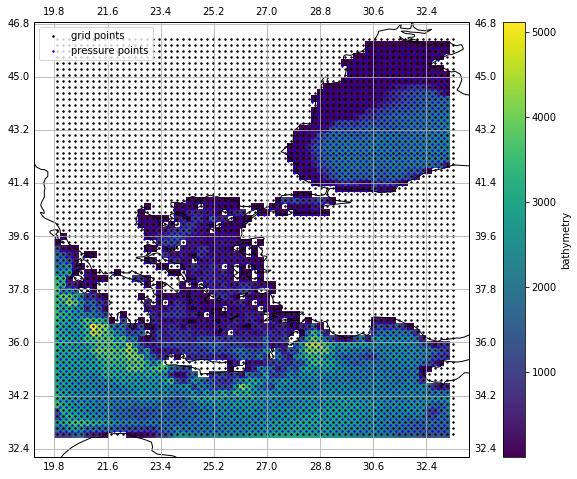

In [29]:
fig = plt.figure(figsize=(12,8))
ax = plt.subplot(projection=ccrs.PlateCarree());

otp.dem.bathymetry.plot.pcolormesh('longitude', 'latitude', ax=ax);

gp = ax.scatter(otp.x, otp.y, s=2, color='k',  label='grid points', transform=ccrs.PlateCarree());

pp = ax.scatter(otp.xh, otp.yh, s=2, color='b', label='pressure points', transform=ccrs.PlateCarree());

ax.legend()

ax.coastlines('50m'); ax.gridlines(draw_labels=True);

### Visualize

In [31]:
%%opts Image [width=650 height=450] (cmap='jet')
otp.hview('S1').to(hv.Image, ['XZ','YZ'], 'S1').hist()

:AdjointLayout
   :HoloMap   [time]
      :Image   [XZ,YZ]   (S1)
   :HoloMap   [time]
      :Histogram   [S1]   (S1_frequency)

In [ ]:
g50 = gv.feature.coastline(plot=dict(scale='50m'), style=dict(linewidth=1.5))

In [60]:
%%opts Image [colorbar=True width=650 height=450 toolbar="above", tools=['hover']] (cmap='viridis')
otp.gview('S1').to(gv.Image, ['XZ','YZ'],dynamic=True) * gf.coastline(plot=dict(scale='50m'), style=dict(linewidth=1.5)) * gf.borders()

Traceback (most recent call last):
  File "/Users/brey/miniconda3/envs/pyPoseidon/lib/python2.7/site-packages/holoviews/plotting/util.py", line 196, in get_plot_frame
    return map_obj[key]
  File "/Users/brey/miniconda3/envs/pyPoseidon/lib/python2.7/site-packages/holoviews/core/spaces.py", line 1029, in __getitem__
    self._cache(tuple_key, val)
  File "/Users/brey/miniconda3/envs/pyPoseidon/lib/python2.7/site-packages/holoviews/core/spaces.py", line 1076, in _cache
    self[key] = val
  File "/Users/brey/miniconda3/envs/pyPoseidon/lib/python2.7/site-packages/holoviews/core/ndmapping.py", line 520, in __setitem__
    self._add_item(key, value, update=False)
  File "/Users/brey/miniconda3/envs/pyPoseidon/lib/python2.7/site-packages/holoviews/core/ndmapping.py", line 157, in _add_item
    self._item_check(dim_vals, data)
  File "/Users/brey/miniconda3/envs/pyPoseidon/lib/python2.7/site-packages/holoviews/core/ndmapping.py", line 821, in _item_check
    (self.__class__.__name__, type(d

:DynamicMap   [time]

In [32]:
otp.frames(['S1'],title='SSH')

INFO:matplotlib.animation:Animation.save using <class 'matplotlib.animation.HTMLWriter'>


In [ ]:
otp.frames(['U1Z','V1Z'],title='Vel',scale=.1)

## Observation points

In [33]:
otp.obs.locations

,SSC ID,Station Name,Country_x,Latitude,Longitude,IOC code,PTWC code,GLOSS ID_x,UHSLC ID,PSMSL ID,...,Country_y,Location,Connection,DCP ID,Last observation Level,Time in GMT,Delay,TransmitInterval,View,point
0,SSC-bodr,Bodrum,Turkey,37.03,27.42,bodr,bodr,NaN,NaN,"1204, 1680",...,Turkey,Bodrum,ftp,NaN,1.06,2017-09-14 15:31,7d,2',[open],NaN
1,SSC-bozy,Bozyazi,Turkey,36.10,32.94,bozy,NaN,NaN,NaN,2014,...,Turkey,Bozyazi,ftp,NaN,1.20,2017-09-14 15:31,7d,2',[open],NaN
2,SSC-corie,Corinth,Greece,37.95,22.94,corn,corn,NaN,NaN,NaN,...,Greece,Corinth,bgan,CORN,0.58,08:37,22',1',[open],NaN
3,SSC-csta,Constanta,Romania,44.16,28.60,csta,NaN,NaN,NaN,379,...,Romania,Constanta,ftp,NaN,-1.17,08:49,10',1',[open],NaN
4,SSC-csta,Constanta,Romania,44.16,28.60,csta,NaN,NaN,NaN,379,...,Romania,Constanta,bgan,CSTA2,-8.01,08:35,24',1',[open],NaN
5,SSC-feth,Fethiye,Turkey,36.62,29.09,feth,feth,NaN,NaN,NaN,...,Turkey,Fethiye,bgan,FETH,1.34,08:37,22',1',[open],NaN
6,SSC-gokc,Gokceada,Turkey,40.23,25.89,gokc,NaN,NaN,NaN,2015,...,Turkey,Gokceada,ftp,NaN,1.03,2017-09-14 15:28,7d,2',[open],NaN
7,SSC-kast,Kasteli,Greece,35.51,23.64,kast,kast,NaN,NaN,NaN,...,Greece,Kasteli,SXXX33,16A5E02C,3.33,2016-12-25 11:22,270d,15',[open],NaN
8,SSC-kata,Katakolo,Greece,37.64,21.32,kata,NaN,NaN,NaN,1240,...,Greece,Katakolo,ftp,NaN,0.56,08:30,29',3',[open],1452.0
9,SSC-koro,Koroni,Greece,36.80,21.96,koro,koro,NaN,NaN,NaN,...,Greece,Koroni,bgan,KORO,NaN,2017-04-27 22:55,146d,1',[open],NaN


In [34]:
# Get with index number
p = otp.obs.iloc(2)
p.head()

ValueError: cannot convert float NaN to integer

In [10]:
#get with Station Name  
p = otp.obs.loc('Alcudia')
p.head()

,Total Sea Level,Tide,Storm Surge
time,,,
2018-01-01 00:00:00,0.421,0.257,0.164
2018-01-01 00:01:00,0.415,0.257,0.158
2018-01-01 00:02:00,0.400,0.257,0.143
2018-01-01 00:03:00,0.385,0.257,0.128
2018-01-01 00:04:00,0.373,0.257,0.116


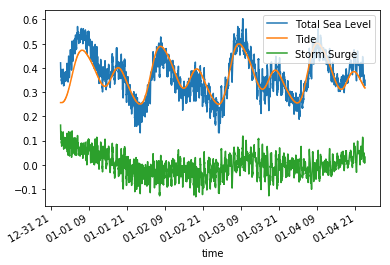

In [11]:
#plot
ax = p.plot()

### sample nearest point from simulation 

In [12]:
 lat,lon = otp.obs.locations.loc[2,['Latitude','Longitude']]

In [13]:
ts = otp.vars.S1.sel(XZ=[lon], method='nearest').sel(YZ=[lat], method='nearest')

In [14]:
ts = ts.squeeze().to_pandas()
ts.head()

time
2018-01-01 00:00:00.000000000    0.000000
2018-01-01 00:19:59.999942656   -0.002909
2018-01-01 00:39:59.999885312   -0.013400
2018-01-01 00:59:59.999959040   -0.020340
2018-01-01 01:19:59.999770624   -0.014003
dtype: float32

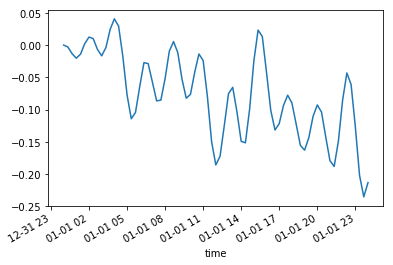

In [15]:
ts.plot()

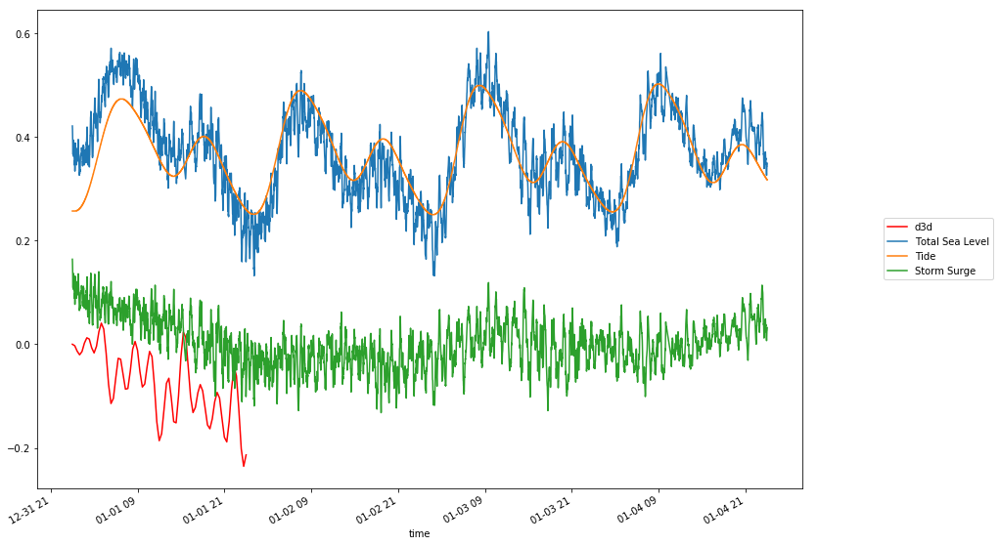

In [16]:
## Join the graphs
ax = ts.plot(figsize=(14,10),color=['r'],label='d3d')
p.plot(ax=ax)
ax.legend(loc='center left',bbox_to_anchor=(1.1, 0.5))